In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import squarify
import plotly.graph_objects as go
import numpy as np
import plotly.express as px
import os
import cv2


In [2]:
batch1 = pd.read_csv("Batch_1_train_labels_clean.csv")
batch1.head()

,image_name,category,subcategory
0,image_631246_product_984304.jpg,Nintendo,Jeux Game Boy Advance
1,image_659698_product_822774.jpg,PlayStation,Jeux PS1
2,image_1063831_product_1157144.jpg,SEGA,Master System
3,image_54547530_product_929584.jpg,PC Gaming,Jeux PC
4,image_62369530_product_2242928.jpg,SEGA,NaN


In [3]:
batch2 = pd.read_csv("Batch_2_train_labels_clean.csv")
batch2.head()

,image_name,category,subcategory
0,image_874729307_product_74244625.jpg,PC Gaming,Jeux PC
1,image_874730792_product_49132716.jpg,Nintendo,Jeux Game Boy Advance
2,image_874731199_product_74093483.jpg,PlayStation,Jeux PS3
3,image_874731370_product_49948298.jpg,Nintendo,Jeux Game Boy Advance
4,image_881487935_product_126111824.jpg,Nintendo,Jeux Nintendo DS


In [4]:
batch3 = pd.read_excel('image_labels_batch_3.xlsx')
batch3.head()

,image_name,category,subcategory
0,image_1117041866_product_1967323837.jpg,PlayStation,Jeux PS1
1,image_891835020_product_106117926.jpg,Sega,Dreamcast
2,image_892937966_product_126159434.jpg,PC Gaming,Jeux PC
3,image_901097569_product_144610449.jpg,PC Gaming,Jeux PC
4,image_909281142_product_153775792.jpg,PlayStation,Jeux PS3


In [5]:
batch4 = pd.read_excel('image_labels_batch_4.xlsx')
batch4.head()

,image_name,category,subcategory
0,image_1043191722_product_848683457.jpg,PC Gaming,Jeux PC Mac
1,image_1049879107_product_957011147.jpg,PC Gaming,Jeux PC
2,image_1053259382_product_1028931562.jpg,PC Gaming,Jeux PC
3,image_1058972548_product_1089685811.jpg,PC Gaming,Jeux PC
4,image_1095315120_product_1634746443.jpg,PC Gaming,Jeux PC


In [6]:
jeux = pd.concat([batch1,batch2,batch3,batch4])
jeux.head()

,image_name,category,subcategory
0,image_631246_product_984304.jpg,Nintendo,Jeux Game Boy Advance
1,image_659698_product_822774.jpg,PlayStation,Jeux PS1
2,image_1063831_product_1157144.jpg,SEGA,Master System
3,image_54547530_product_929584.jpg,PC Gaming,Jeux PC
4,image_62369530_product_2242928.jpg,SEGA,NaN


color palette nintendo :
 #fdfdfe 
	#cecdd3 
	#c42317
	#847f7e 
	#000000 	

color palette playstation:
#df0024 
	#f3c300 
	#00ab9f 
	#2e6db4 

color palette x box:
#ffffff 
	#77bb44 
	#2ca243 
	#107c10 
	#000000

color palette sega:
#17569b 
	#4578af
	#749ac3 
	#a2bbd7 
	#d1ddeb

color palette pc gaming:
#ffffff 
	#dedede 
	#0a4fa4 
	#020812 
	#fdd425

color palette vtech:
#205493
#003366

In [7]:
jeux['category'] = jeux['category'].replace('Sega', 'SEGA')

In [8]:
jeux['category'].unique()

array(['Nintendo', 'PlayStation', 'SEGA', 'PC Gaming', 'Xbox', 'VTECH',
       'Autre', 'Outlier', 'Arcade', 'Réalité Virtuelle', 'Mobile Gaming'],
      dtype=object)

Répartition des Catégories de Produits


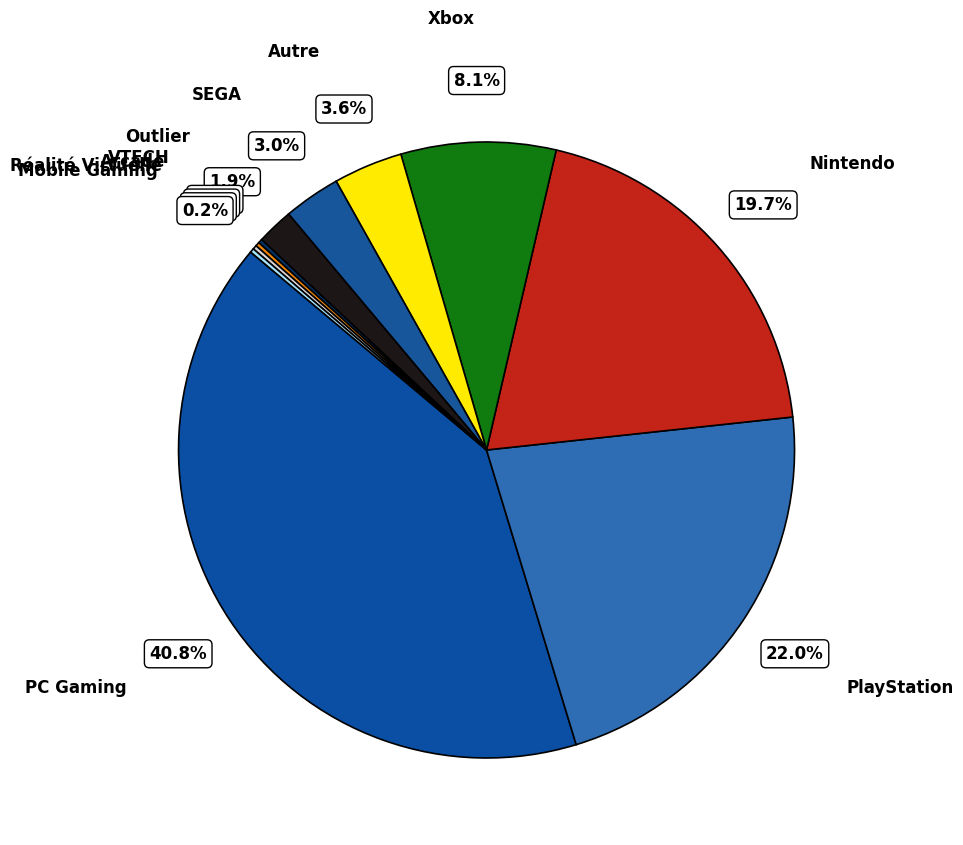

In [9]:
category_colors = {
    'Nintendo': '#c42317',       # Rouge
    'PlayStation': '#2e6db4',    # Bleu
    'Xbox': '#107c10',          # Vert
    'SEGA': '#17569b',          # Bleu foncé
    'PC Gaming': '#0a4fa4',
    'VTECH': '#003366',
    'Autre': '#FFEB00',
    'Outlier': '#1D1616',
    'Arcade': '#EC8305',
    'Réalité Virtuelle':'#DBD3D3',
    'Mobile Gaming':'#A7E6FF'
}

# Compter le nombre d'occurrences par catégorie
category_counts = jeux['category'].value_counts()

# Appliquer les couleurs correspondantes
colors = [category_colors[cat] for cat in category_counts.index]

# Création du pie chart avec une meilleure esthétique
plt.figure(figsize=(10, 10))
wedges, texts, autotexts = plt.pie(
    category_counts, labels=category_counts.index, autopct='%1.1f%%',
    colors=colors, startangle=140, wedgeprops={'edgecolor': 'black', 'linewidth': 1.2},
    pctdistance=1.2,
    labeldistance=1.4
)

# Personnalisation du texte pour plus de visibilité
for text in texts + autotexts:
    text.set_fontsize(12)
    text.set_color("black")
    text.set_weight("bold")

for text in texts:
    text.set_fontsize(12)
    text.set_color("black")
    text.set_weight("bold")

for autotext in autotexts:
    autotext.set_fontsize(12)
    autotext.set_color("black")
    autotext.set_weight("bold")
    autotext.set_bbox(dict(facecolor='white', edgecolor='black', boxstyle='round,pad=0.3'))

# Titre du graphique
print("Répartition des Catégories de Produits")
plt.show()

In [10]:
# Supposons que ton DataFrame 'jeux' contient 'category' et 'sub_category'
selected_category = jeux['category'].unique()

for cat in selected_category:
    df_selected = jeux[jeux['category'] == cat]
    sub_category_counts = df_selected['subcategory'].value_counts()

    # Préparer les données pour le radar chart
    categories = list(sub_category_counts.index)
    values = list(sub_category_counts.values)
    categories.append(categories[0])  # On boucle pour fermer le radar
    values.append(values[0])  # Même valeur pour fermer le radar

    # Création du Scatterpolar
    fig = go.Figure()

    fig.add_trace(go.Scatterpolar(
        r=values,
        theta=categories,
        fill='toself',
        name=cat
    ))

    # Mise en forme du radar chart
    fig.update_layout(
        polar=dict(
            radialaxis=dict(visible=True, range=[0, max(values) * 1.2])  # Ajuster l'échelle
        ),
        title=f"Répartition des sous-catégories pour {cat}",
        showlegend=True
    )

    # Afficher la figure
    fig.show()

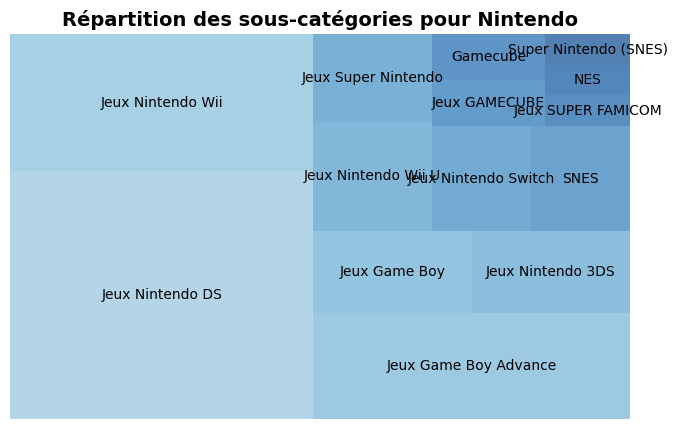

In [11]:
# Filtrer une catégorie spécifique (ex: 'Nintendo')
df_nintendo = jeux[jeux['category'] == 'Nintendo']
sub_category_counts = df_nintendo['subcategory'].value_counts()

# Création du Treemap
plt.figure(figsize=(8, 5))
squarify.plot(sizes=sub_category_counts.values, label=sub_category_counts.index, 
            color=plt.cm.Blues(np.linspace(0.4, 0.9, len(sub_category_counts))), 
            alpha=0.7)

plt.axis('off')
plt.title("Répartition des sous-catégories pour Nintendo", fontsize=14, fontweight="bold")
plt.show()

In [12]:
df_treemap = jeux.groupby(['category', 'subcategory']).size().reset_index(name='count')

# Création du Treemap
fig = px.treemap(df_treemap, 
                path=['category', 'subcategory'],  # Hiérarchie Catégorie -> Sous-catégorie
                values='count',
                color='category',
                title="Répartition des Catégories et Sous-catégories")
fig.show()

In [13]:
# Créer un DataFrame avec la répartition des sous-catégories par catégorie
df_sunburst = jeux.groupby(['category', 'subcategory']).size().reset_index(name='count')

# Calcul du total global des jeux
total_count = df_sunburst["count"].sum()

# Ajouter une colonne avec les pourcentages
df_sunburst["percentage"] = (df_sunburst["count"] / total_count) * 100

# Création du graphique Sunburst
fig = px.sunburst(df_sunburst, 
                path=['category', 'subcategory'], 
                values='percentage', 
                color='category',
                title="Répartition des Catégories et Sous-catégories")

fig.update_layout(width=1000, height=1000)
fig.show()

<>:1: SyntaxWarning:

invalid escape sequence '\D'

<>:1: SyntaxWarning:

invalid escape sequence '\D'

C:\Users\Daigona\AppData\Local\Temp\ipykernel_12360\4018186491.py:1: SyntaxWarning:

invalid escape sequence '\D'



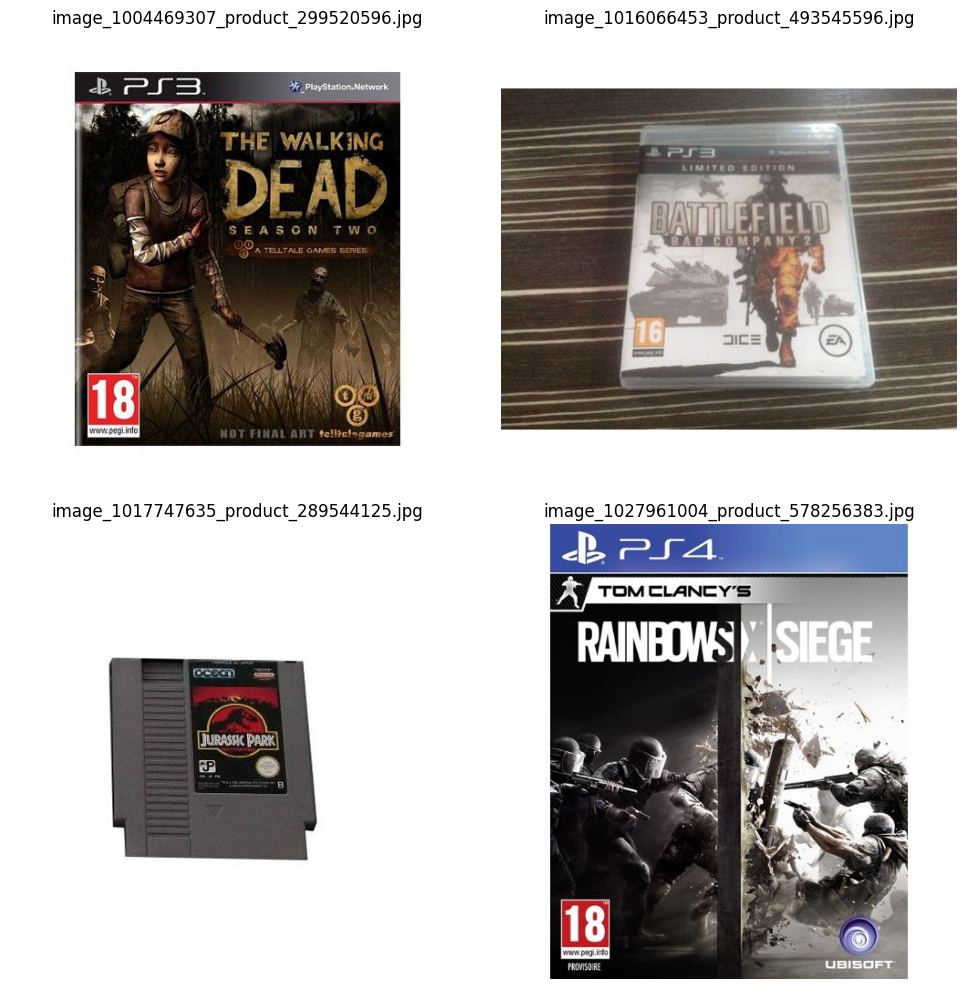

In [14]:
image_folder = "F:\Document\Datascientest\Projet_final\images\Batch_1_train"

image_files = sorted([f for f in os.listdir(image_folder) if f.endswith((".png", ".jpg", ".jpeg"))])[:4]
# Créer une figure avec une grille 2x2
fig, axes = plt.subplots(2, 2, figsize=(10, 10))  # Grille 2x2 avec taille ajustée

# Parcourir les images et les afficher
for ax, img_file in zip(axes.flatten(), image_files):
    img_path = os.path.join(image_folder, img_file)
    img = cv2.cvtColor(cv2.imread(img_path), cv2.COLOR_BGR2RGB)  # Charger en RGB
    
    ax.imshow(img)
    ax.set_title(img_file)  # Ajouter le nom de l'image en titre
    ax.axis("off")  # Supprimer les axes pour un affichage propre

# Afficher la figure
plt.tight_layout()  # Ajuster automatiquement les espacements
plt.show()

<>:1: SyntaxWarning:

invalid escape sequence '\D'

<>:1: SyntaxWarning:

invalid escape sequence '\D'

C:\Users\Daigona\AppData\Local\Temp\ipykernel_12360\1844122694.py:1: SyntaxWarning:

invalid escape sequence '\D'



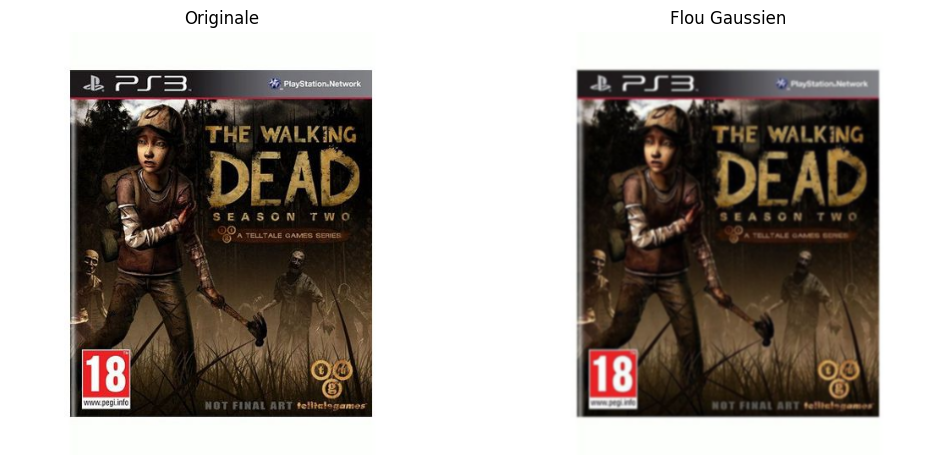

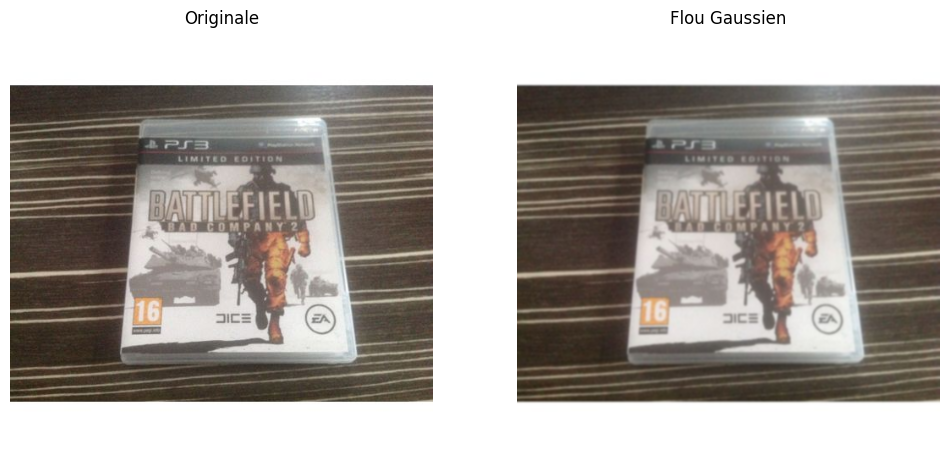

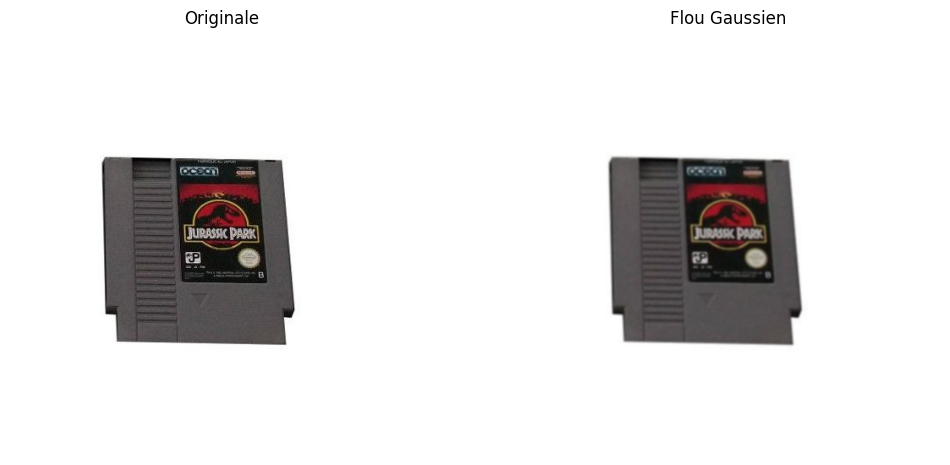

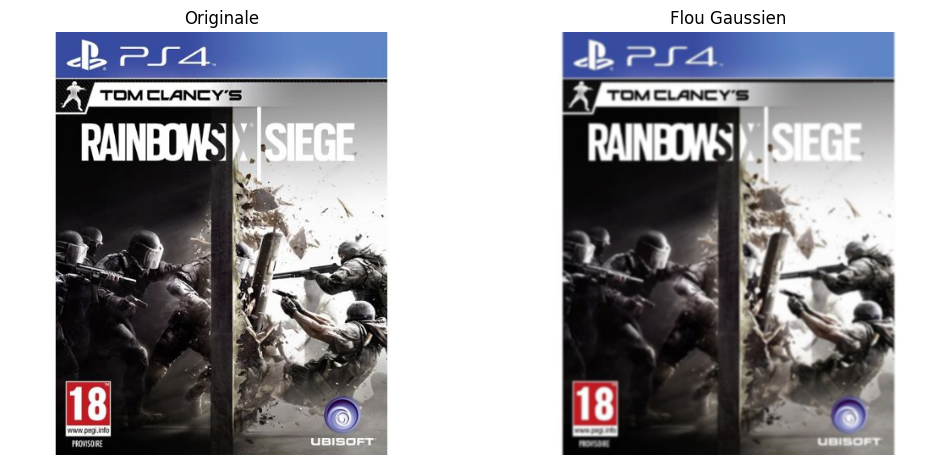

In [15]:
image_folder = "F:\Document\Datascientest\Projet_final\images\Batch_1_train"

image_files = sorted([f for f in os.listdir(image_folder) if f.endswith((".png", ".jpg", ".jpeg"))])[:4]

for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    
    # Appliquer un flou gaussien
    img_blur = cv2.GaussianBlur(img, (5,5), 0)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(img_blur)
    axes[1].set_title("Flou Gaussien")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

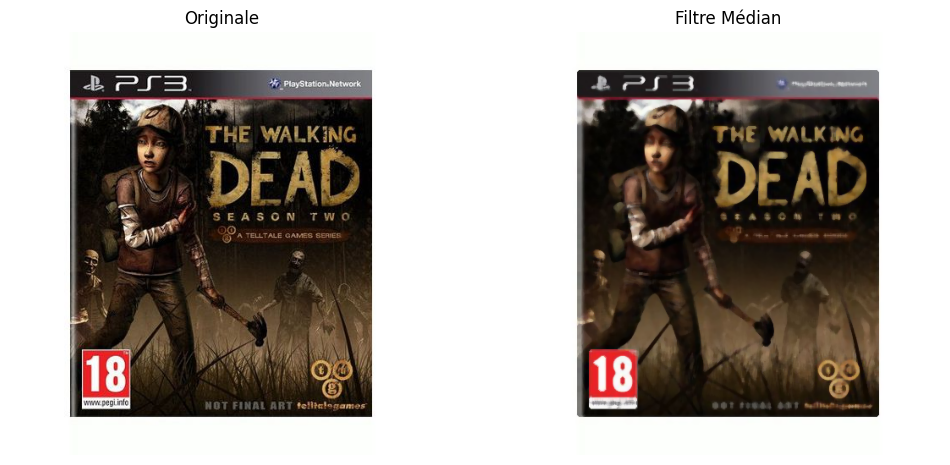

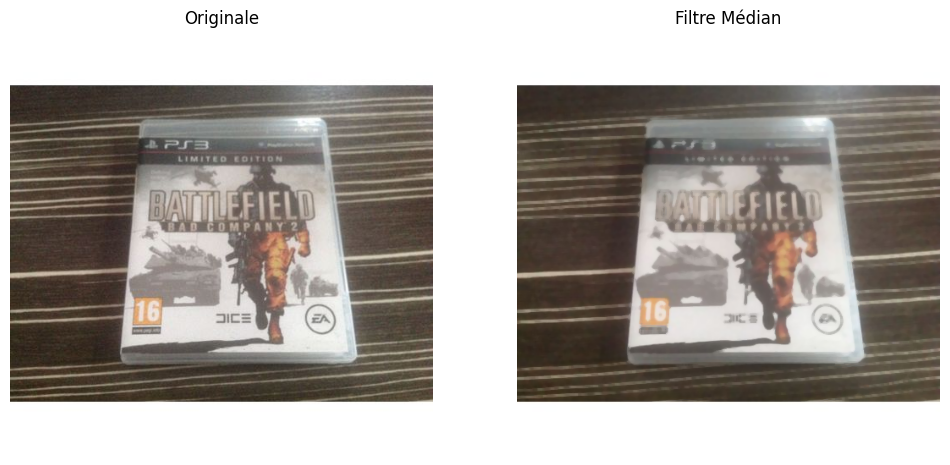

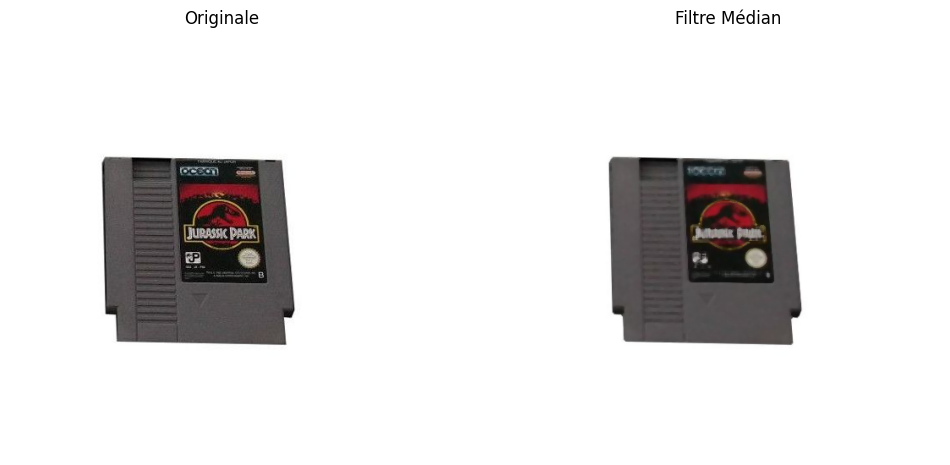

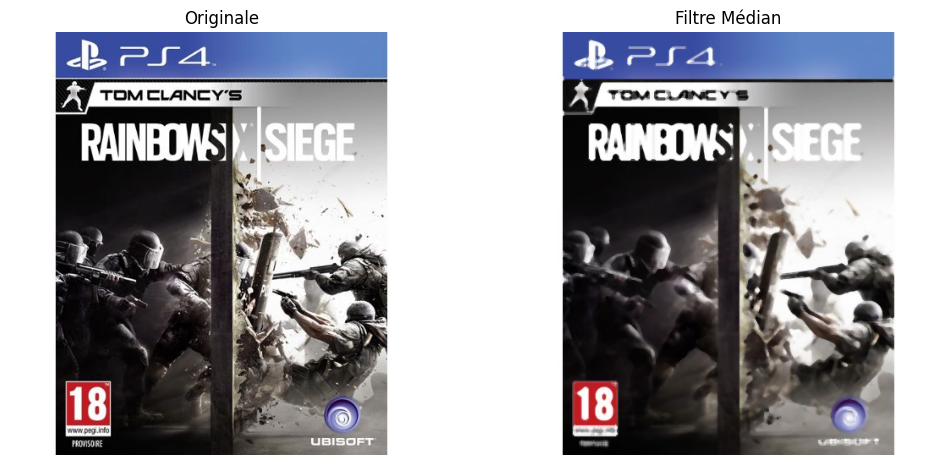

In [16]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    
    # Appliquer un flou gaussien
    img_median = cv2.medianBlur(img, 5)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(img_median)
    axes[1].set_title("Filtre Médian")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

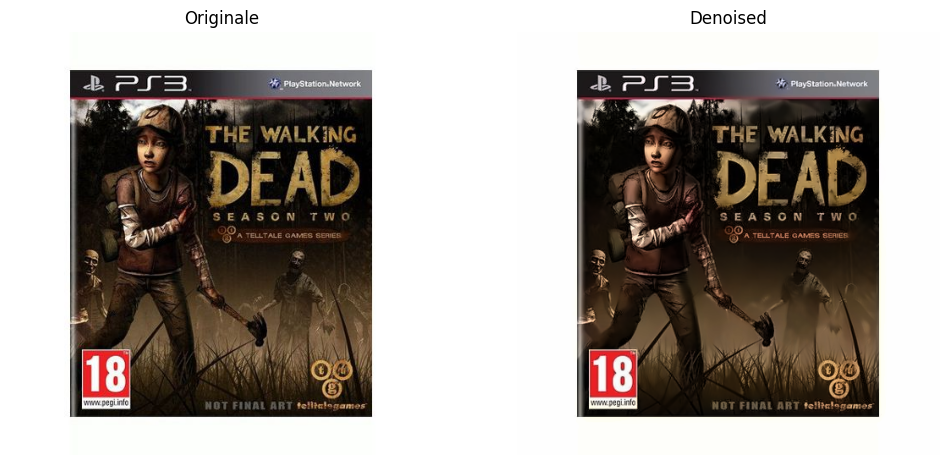

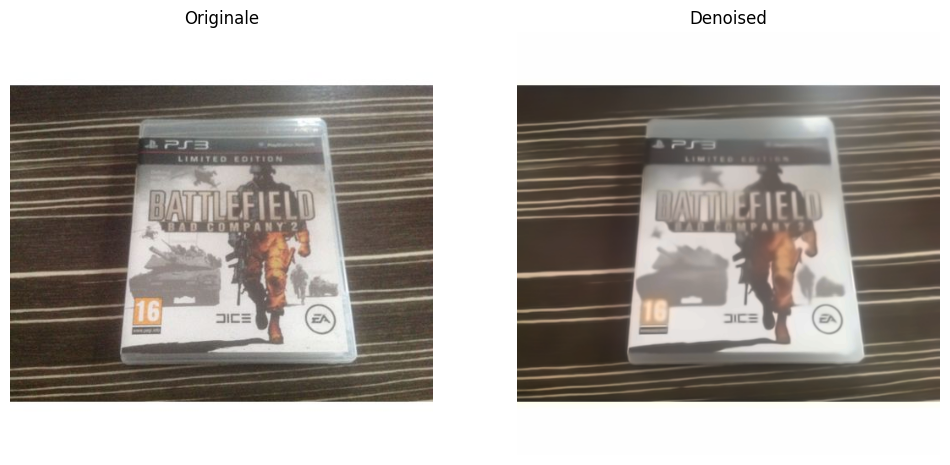

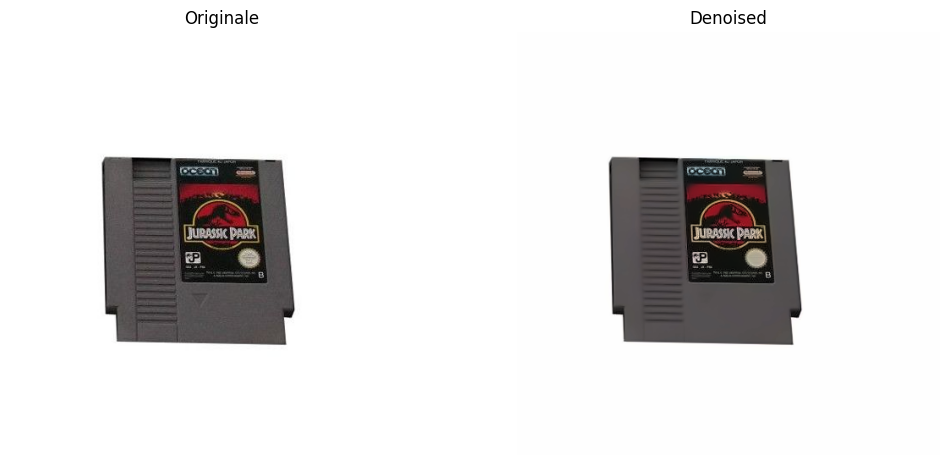

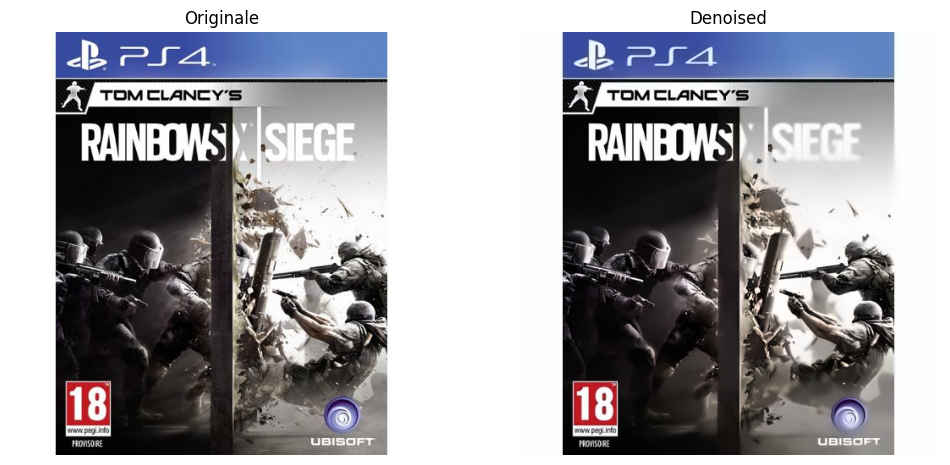

In [17]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    
    # Appliquer un flou gaussien
    img_denoised = cv2.fastNlMeansDenoisingColored(img, None, 10, 10, 7, 21)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(img_denoised)
    axes[1].set_title("Denoised")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

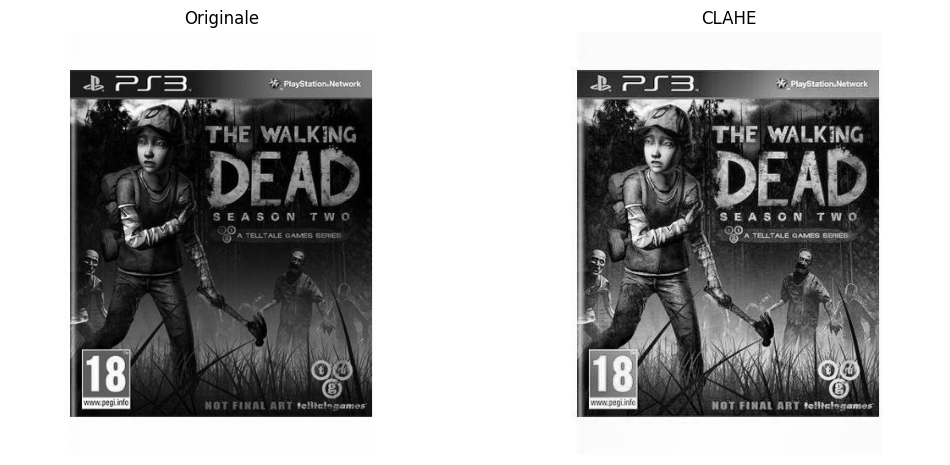

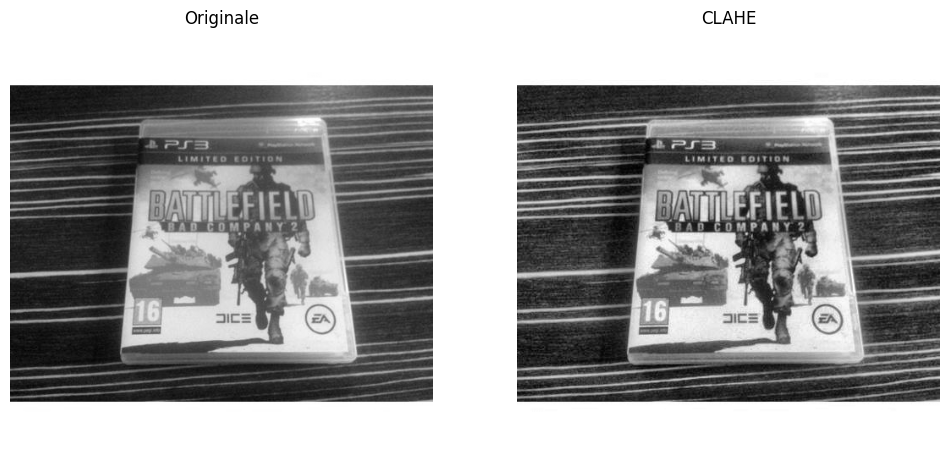

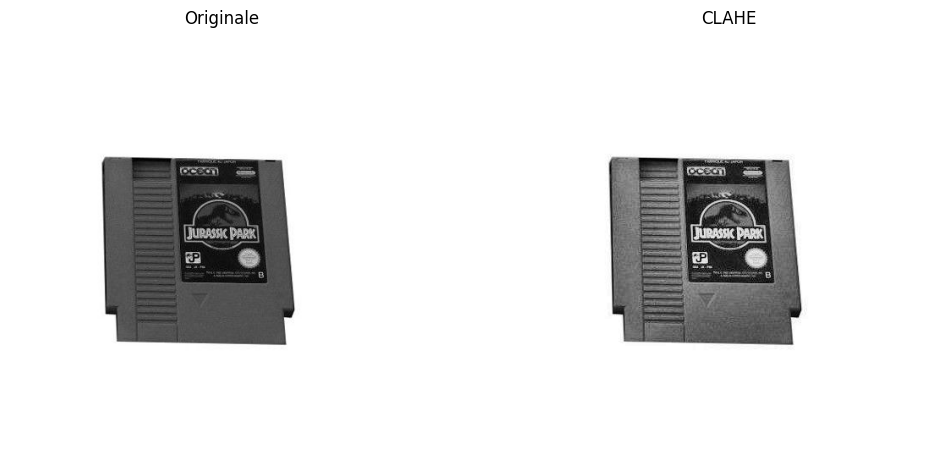

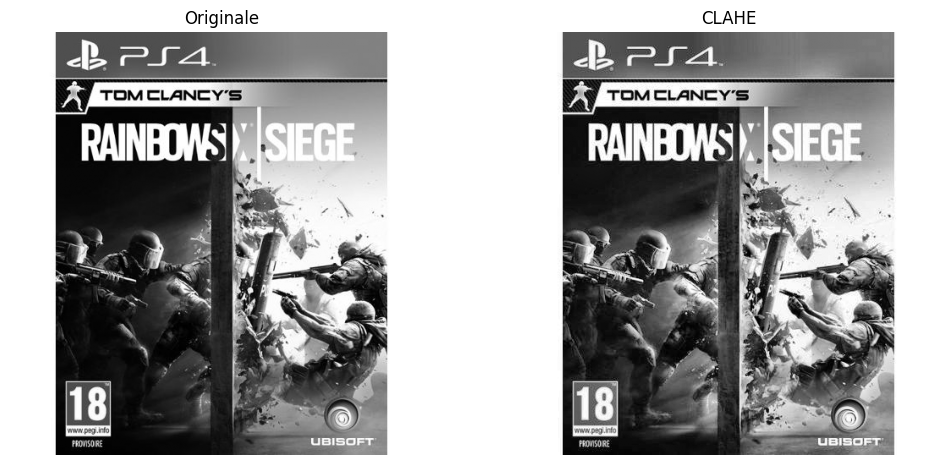

In [18]:
for img_file in image_files:
    # Charger l'image en niveaux de gris
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Conversion en niveaux de gris
    
    # Appliquer CLAHE (Contrast Limited Adaptive Histogram Equalization)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    img_clahe = clahe.apply(gray)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Affichage de l'image originale en niveaux de gris
    axes[0].imshow(gray, cmap='gray')
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes

    # Affichage de l'image après traitement CLAHE
    axes[1].imshow(img_clahe, cmap='gray')
    axes[1].set_title("CLAHE")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

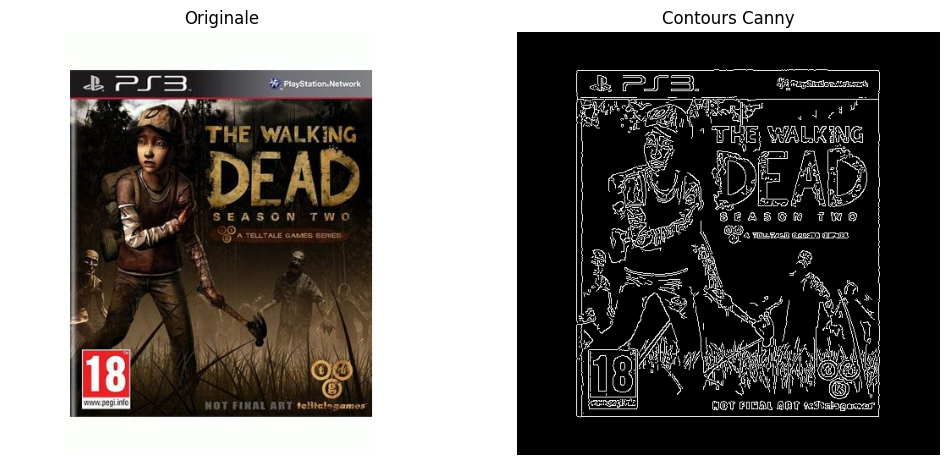

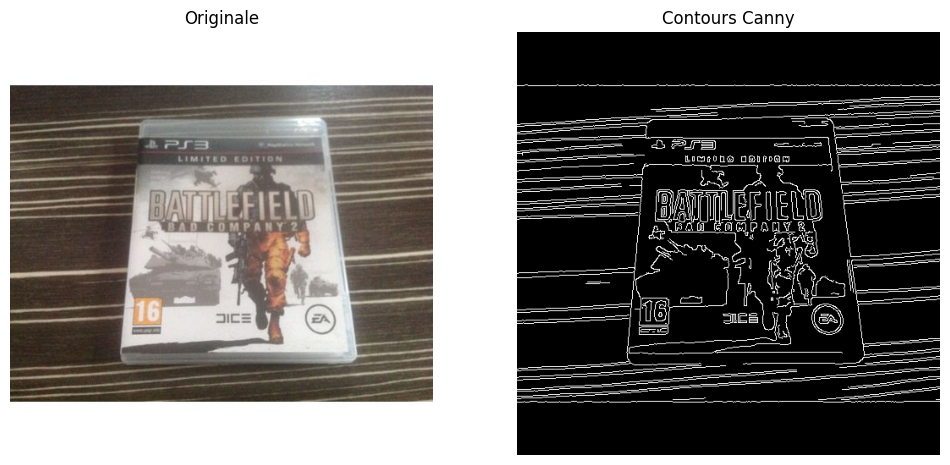

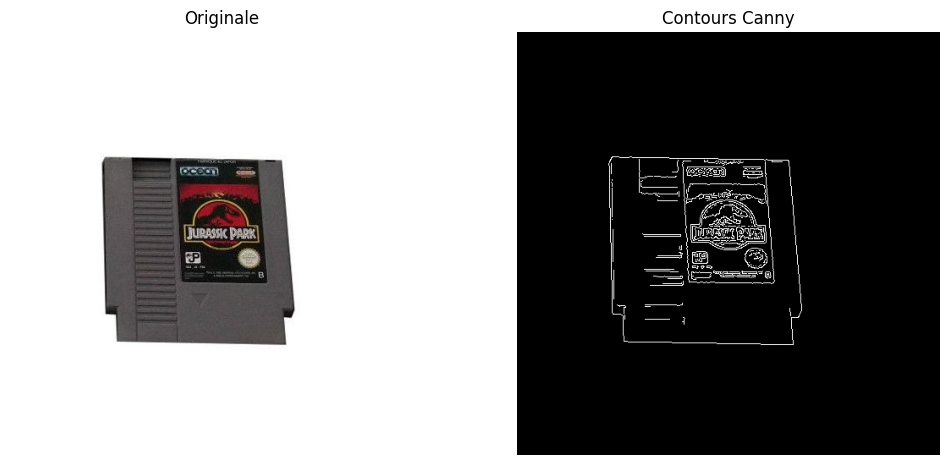

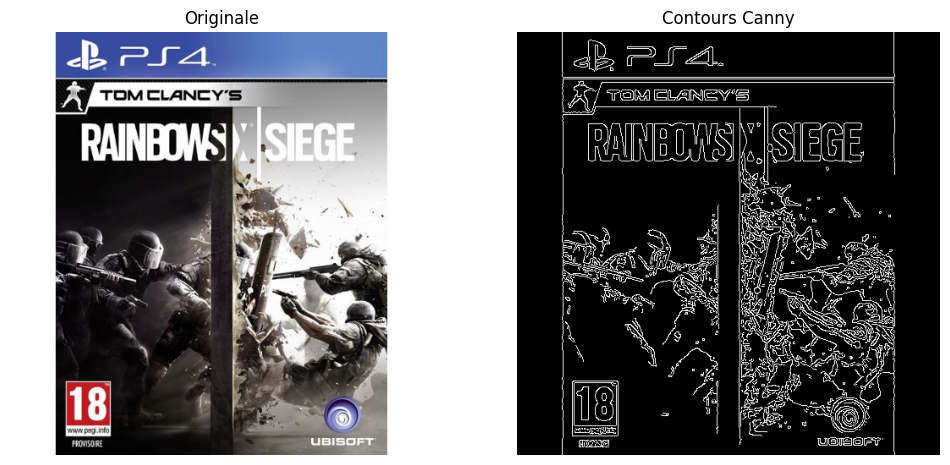

In [19]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convertir en RGB pour Matplotlib
    
    # Appliquer un flou gaussien
    edges = cv2.Canny(img, 100, 200)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(edges, cmap='gray')
    axes[1].set_title("Contours Canny")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

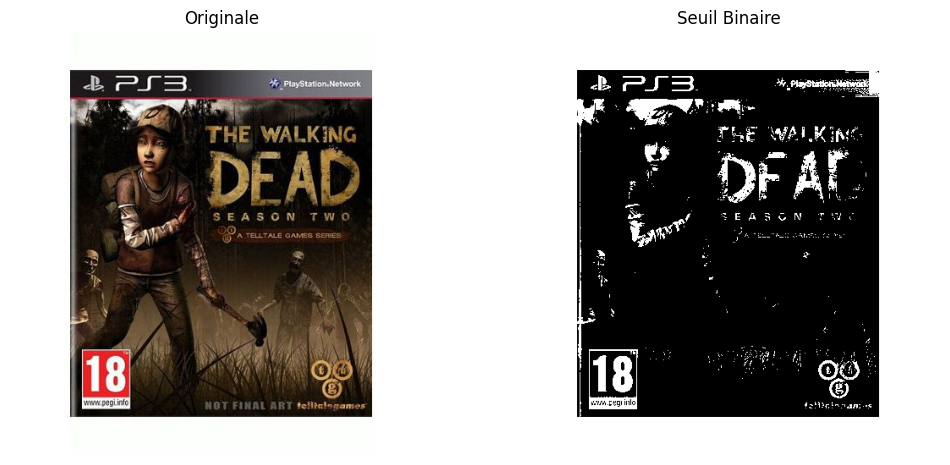

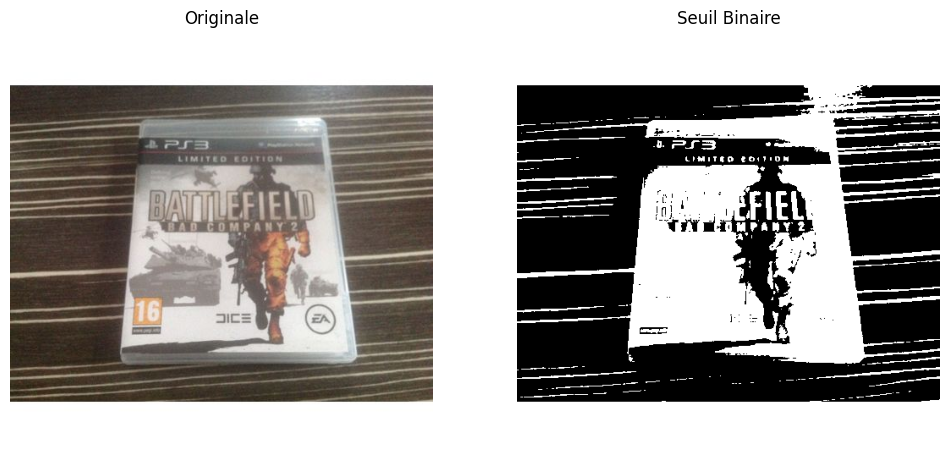

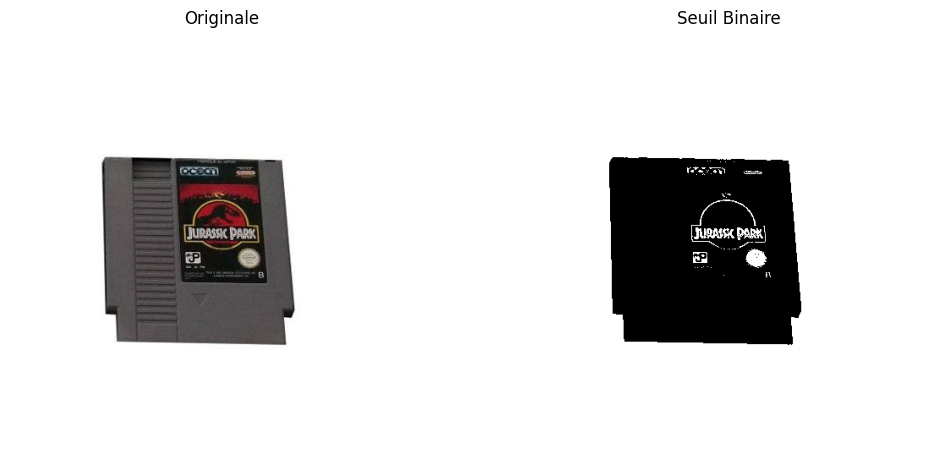

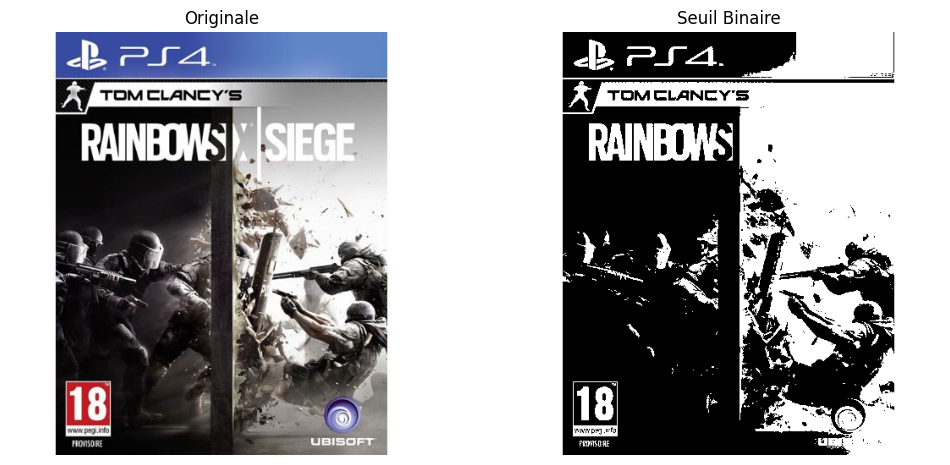

In [20]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convertir en RGB pour Matplotlib
    
    # Appliquer un flou gaussien
    _, binary = cv2.threshold(gray, 127, 255, cv2.THRESH_BINARY)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(binary, cmap='gray')
    axes[1].set_title("Seuil Binaire")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

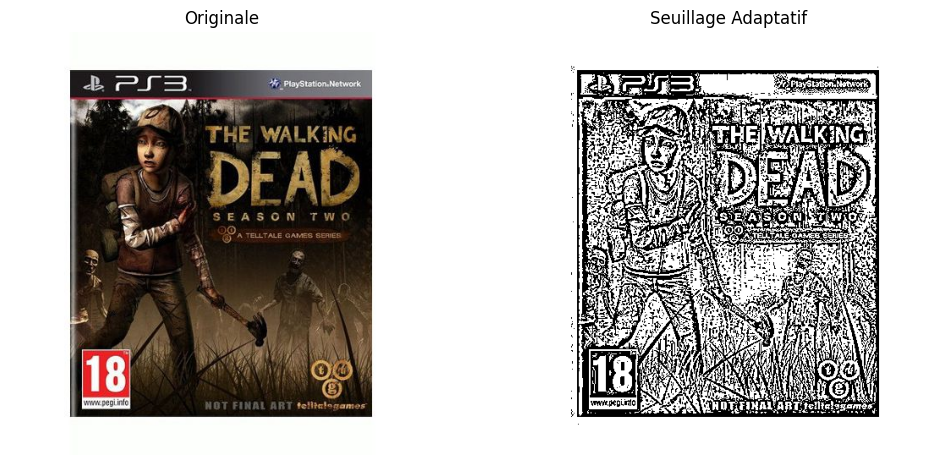

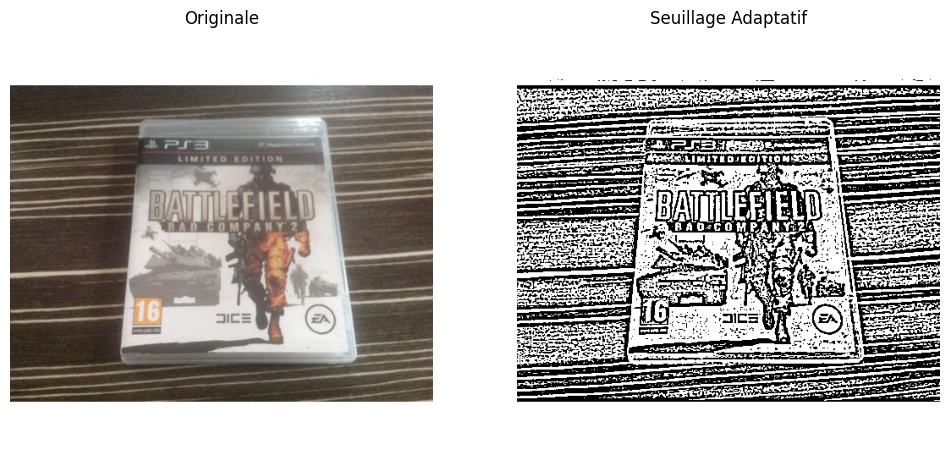

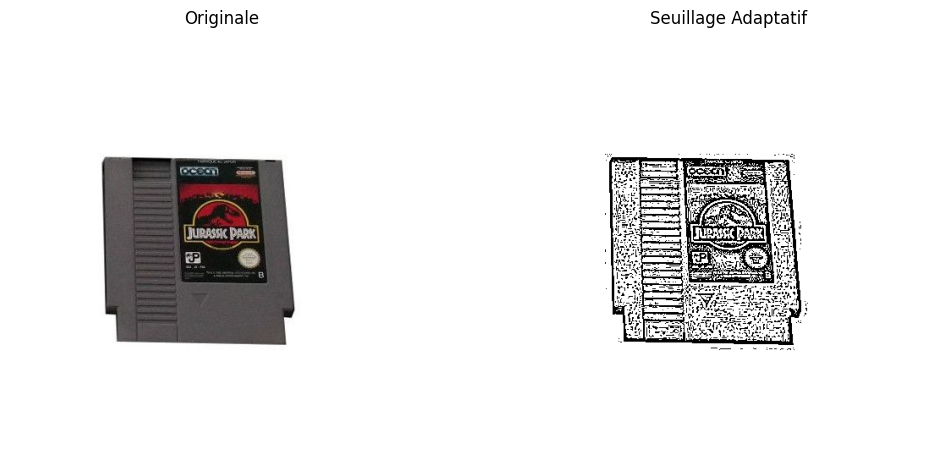

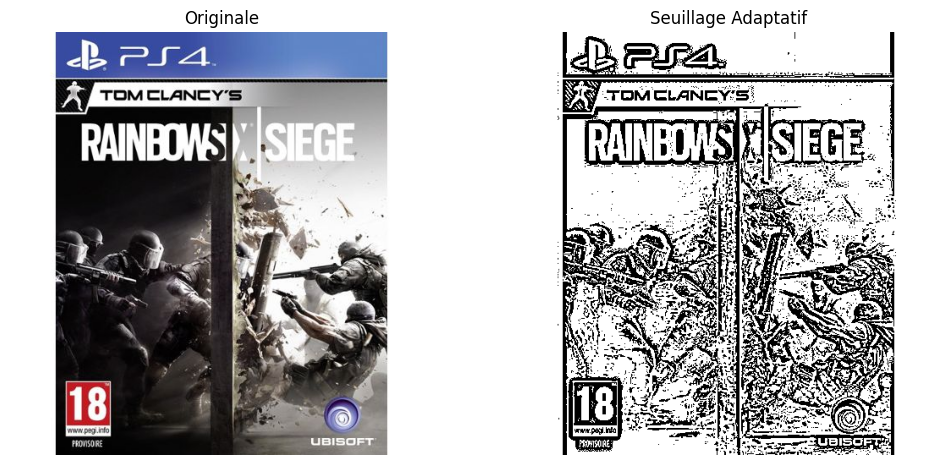

In [21]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convertir en RGB pour Matplotlib
    
    # Appliquer un flou gaussien
    adaptive = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(adaptive, cmap='gray')
    axes[1].set_title("Seuillage Adaptatif")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

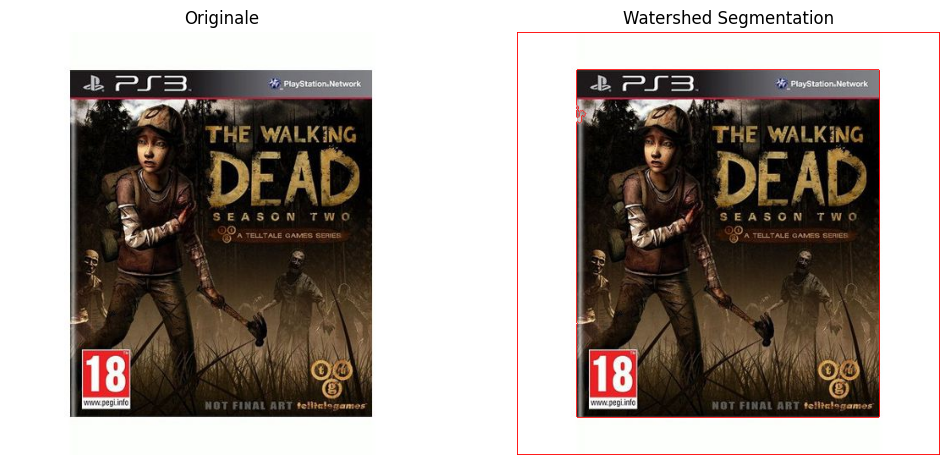

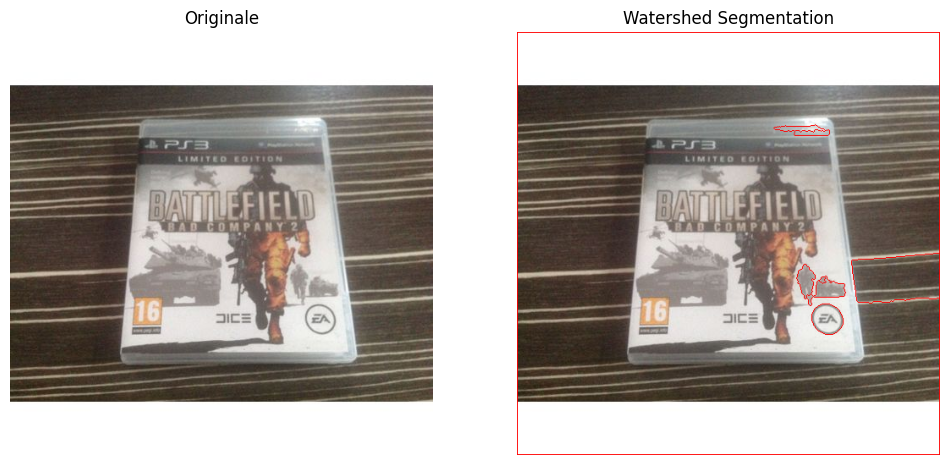

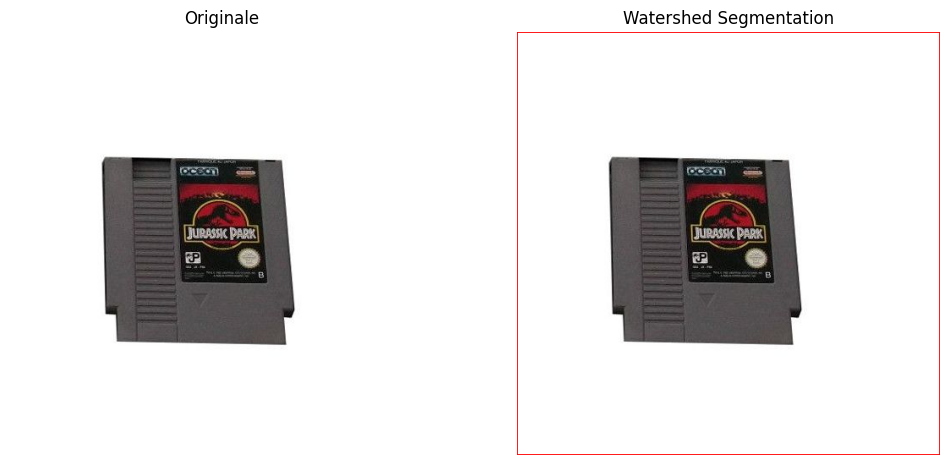

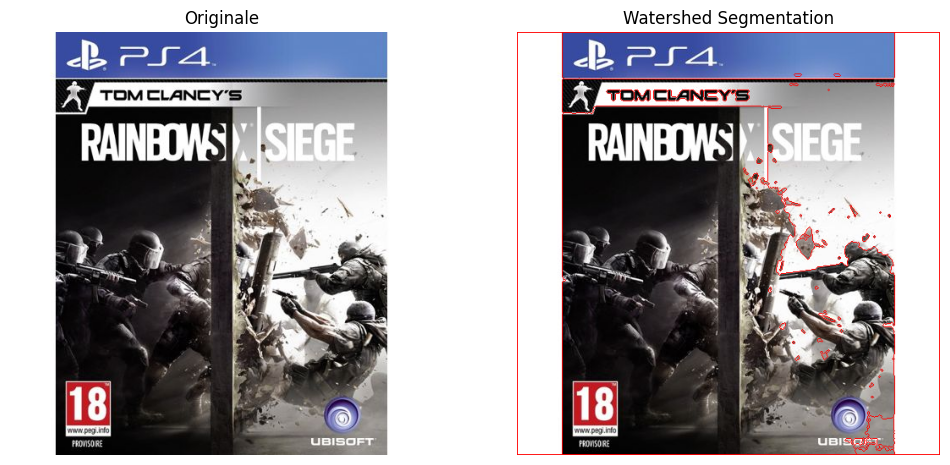

In [22]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convertir en RGB pour Matplotlib
    
    # Appliquer un flou gaussien
    _, binary = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    markers = np.zeros_like(gray, dtype=np.int32)
    for i, contour in enumerate(contours):
        cv2.drawContours(markers, [contour], -1, i + 1, -1)

        # Appliquer Watershed
    cv2.watershed(img, markers)
    img_watershed = img_rgb.copy()
    img_watershed[markers == -1] = [255, 0, 0]

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(img_watershed,)
    axes[1].set_title("Watershed Segmentation")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

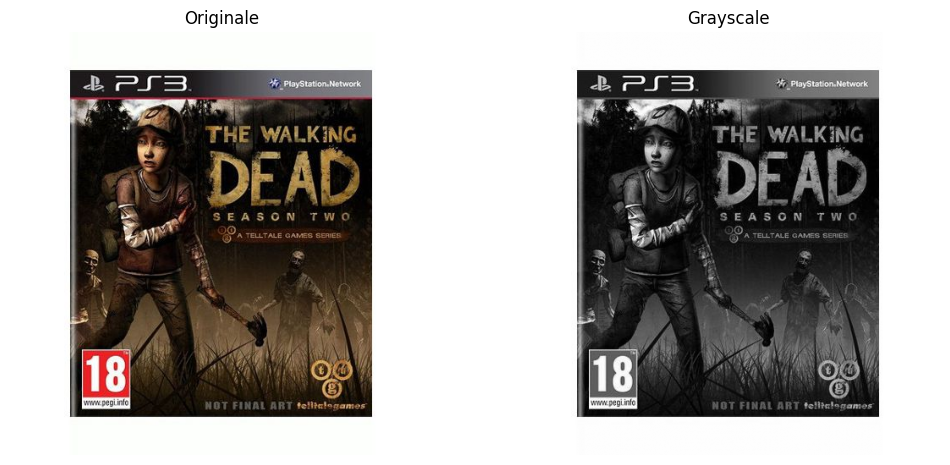

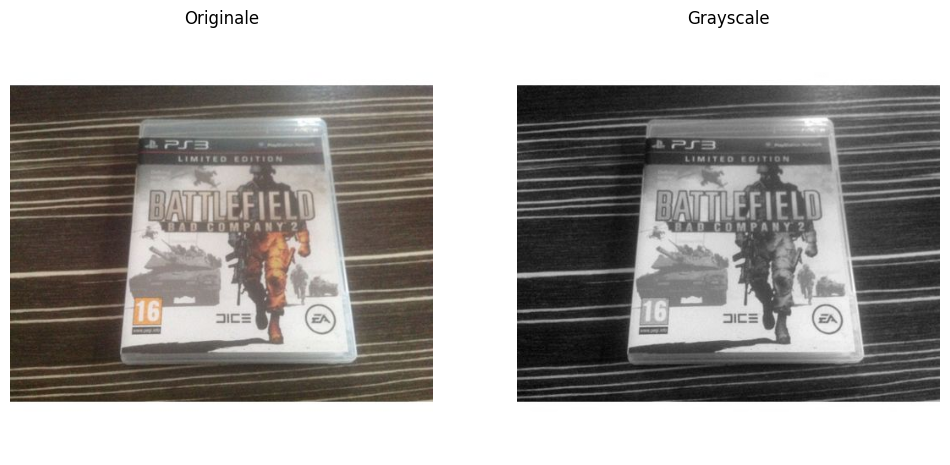

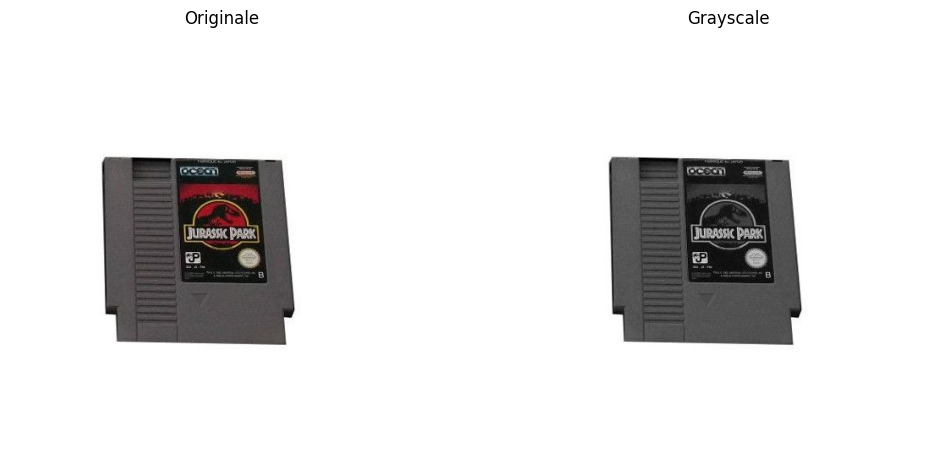

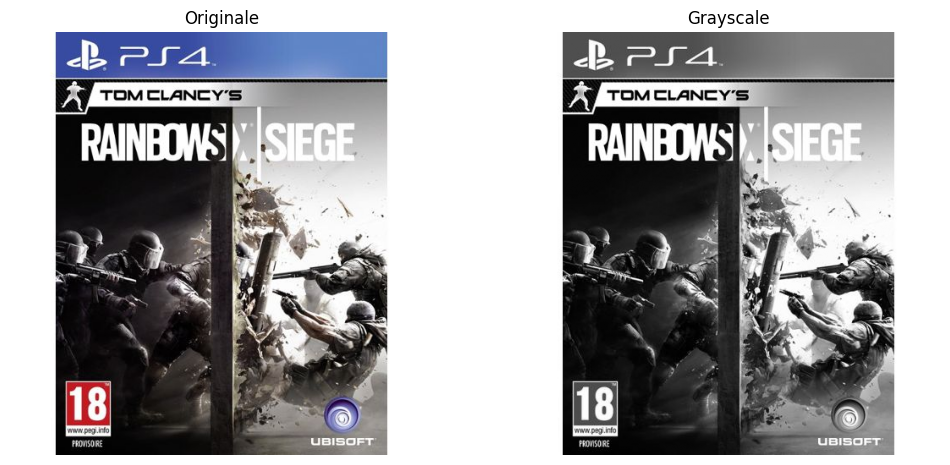

In [23]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convertir en RGB pour Matplotlib
    
    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(gray,cmap='gray')
    axes[1].set_title("Grayscale")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

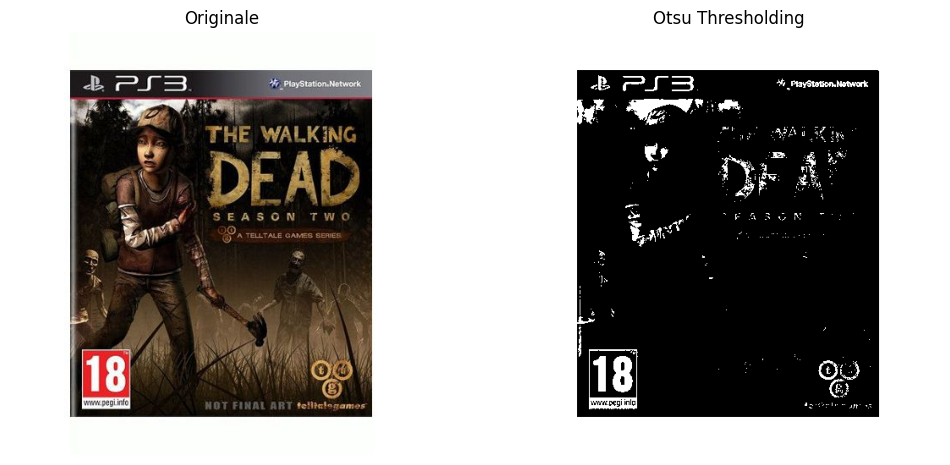

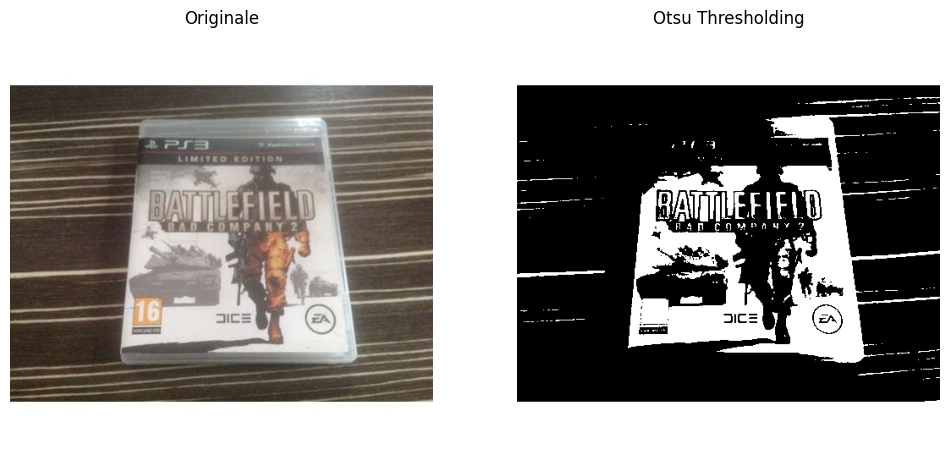

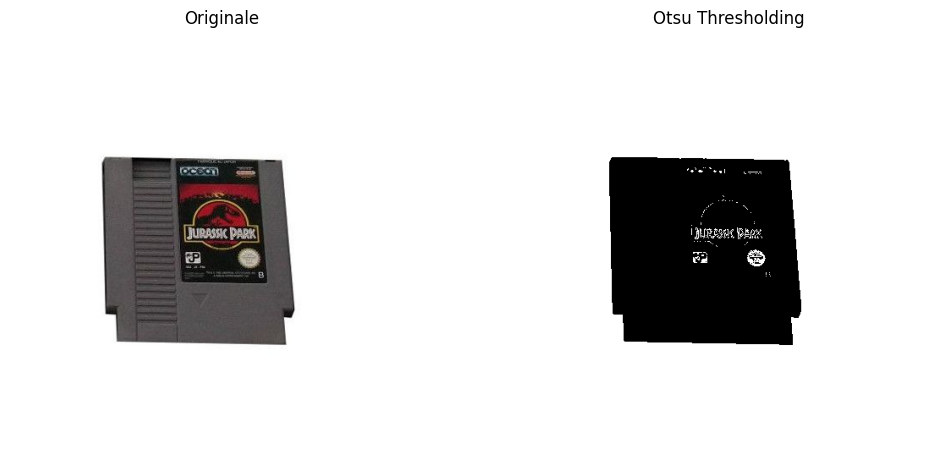

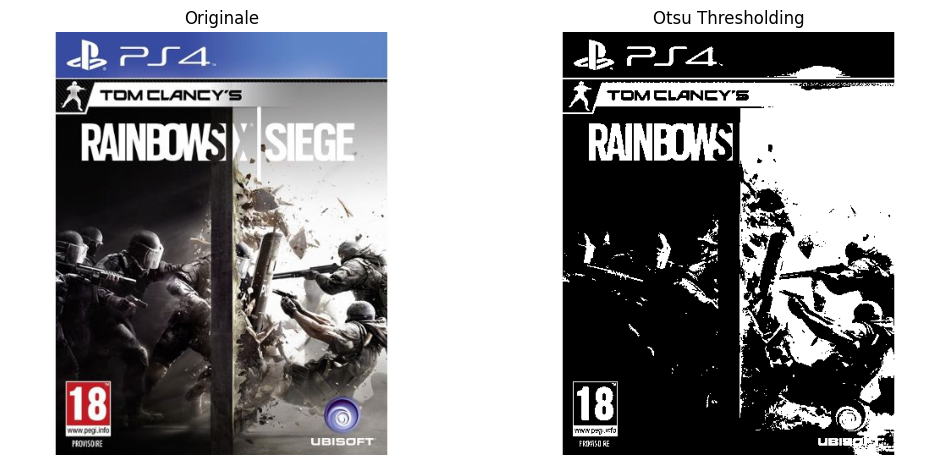

In [24]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convertir en RGB pour Matplotlib
    
    _, otsu = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(otsu, cmap='gray')
    axes[1].set_title("Otsu Thresholding")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

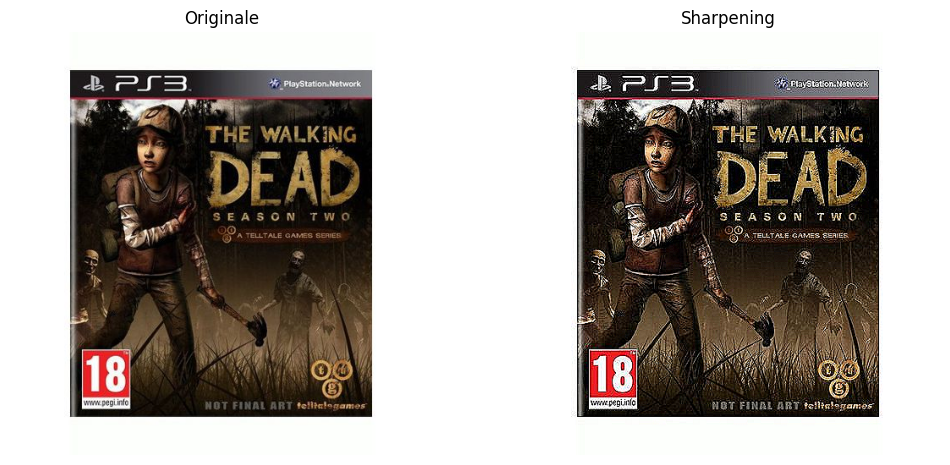

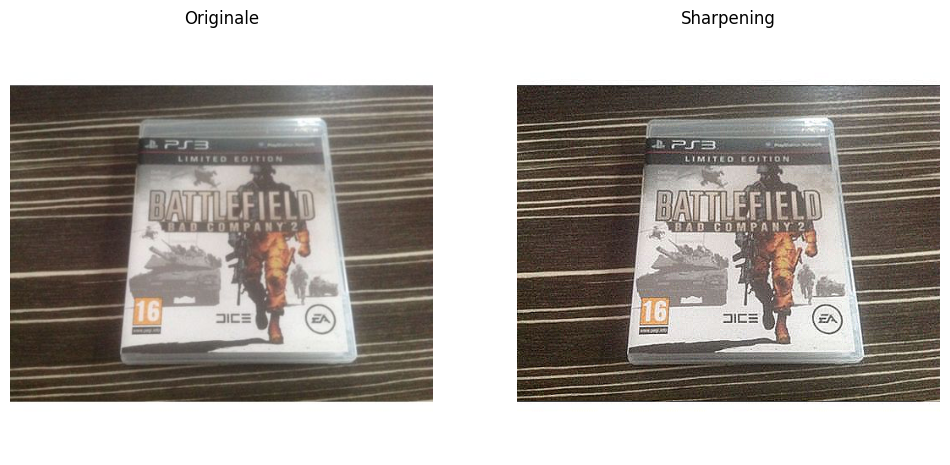

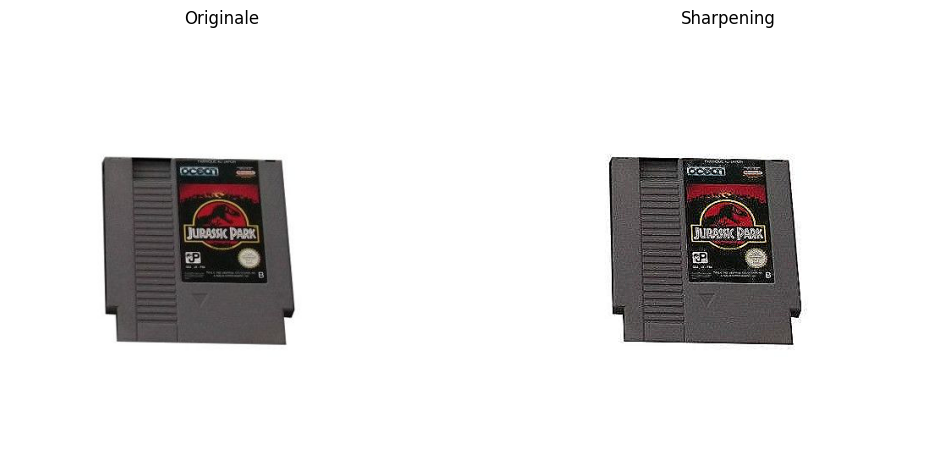

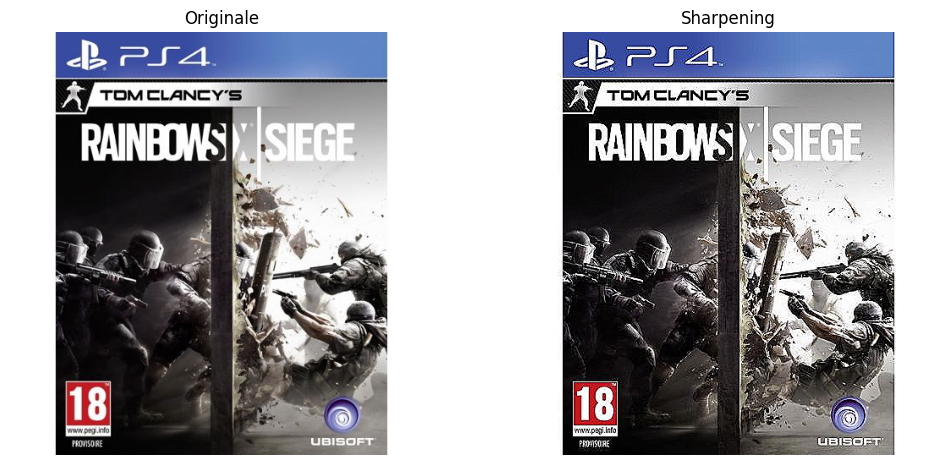

In [25]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    sharpen_kernel = np.array([[0, -1, 0], 
                            [-1, 5, -1], 
                            [0, -1, 0]])
    sharpened = cv2.filter2D(img, -1, sharpen_kernel)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(cv2.cvtColor(sharpened, cv2.COLOR_BGR2RGB))
    axes[1].set_title("Sharpening")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

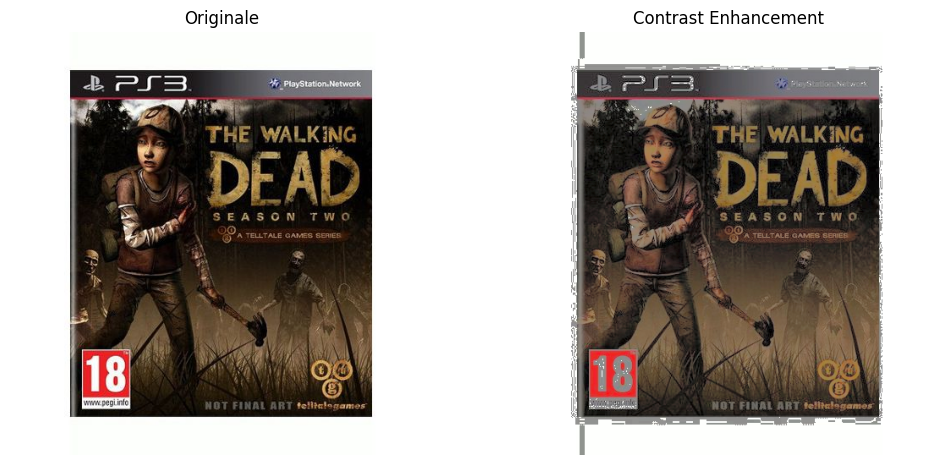

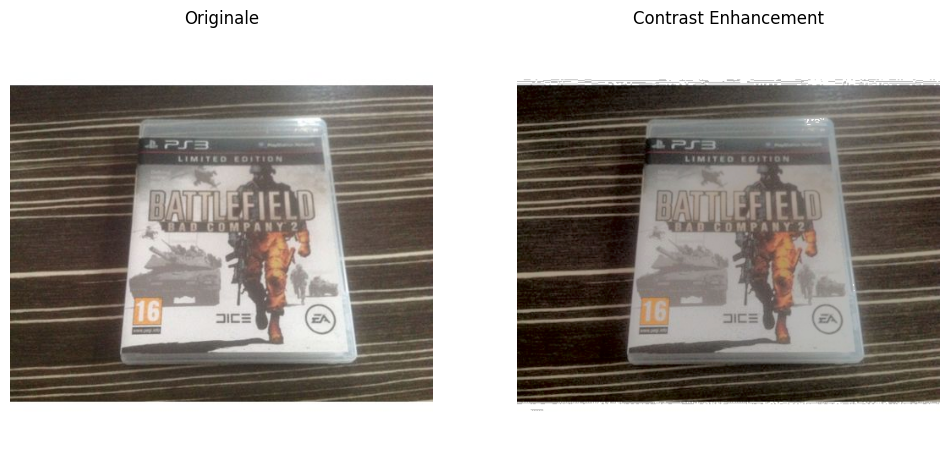

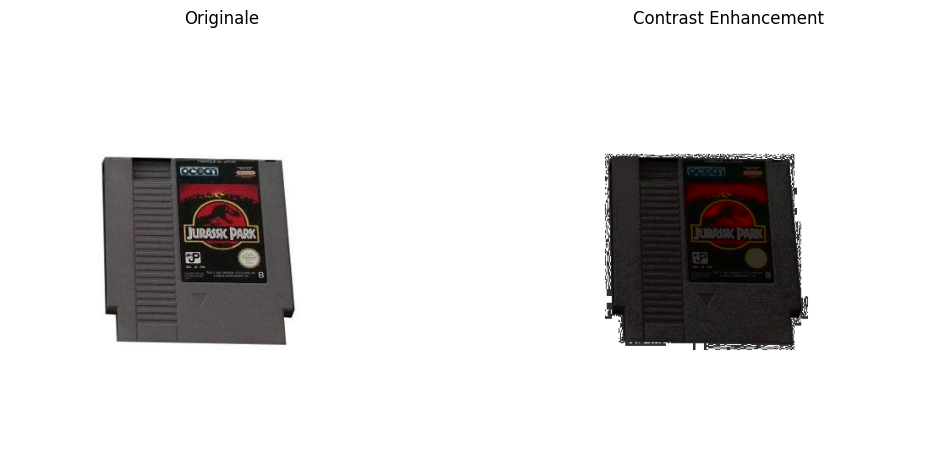

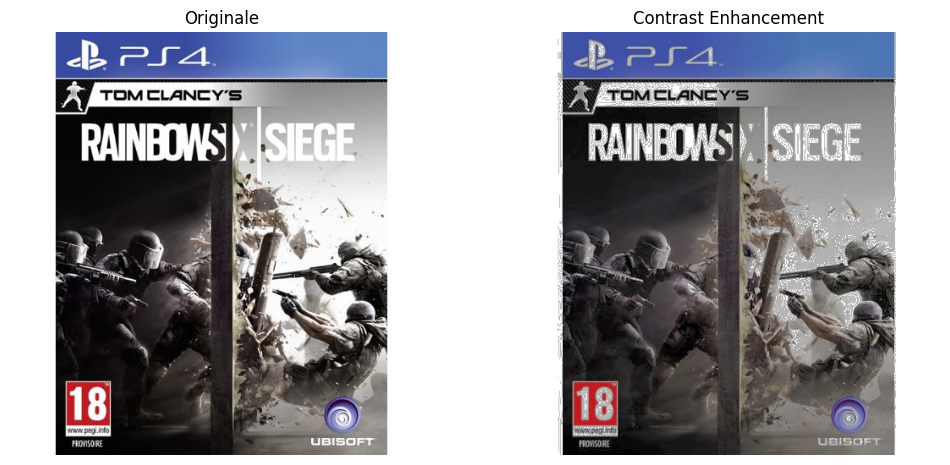

In [26]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convertir en RGB pour Matplotlib
    
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    l = cv2.equalizeHist(l)
    img_contrast = cv2.merge((l, a, b))
    img_contrast = cv2.cvtColor(img_contrast, cv2.COLOR_LAB2BGR)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(cv2.cvtColor(img_contrast, cv2.COLOR_BGR2RGB))
    axes[1].set_title("Contrast Enhancement")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

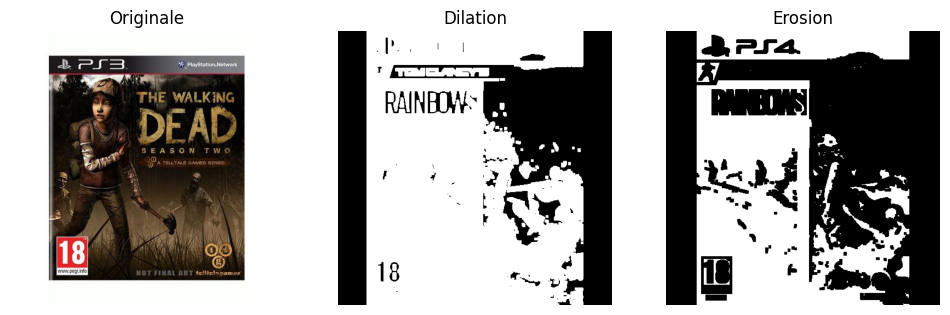

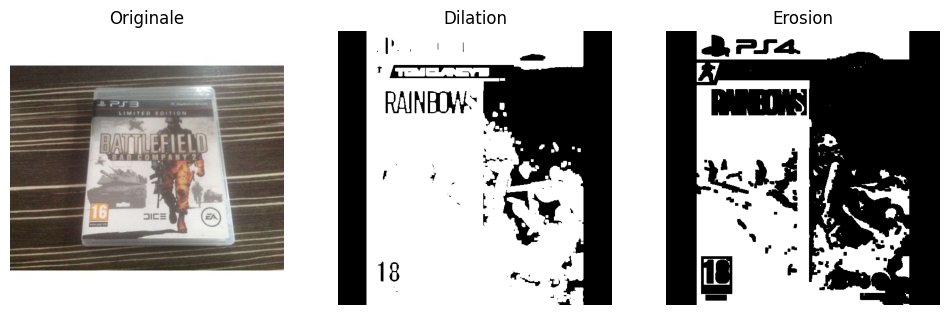

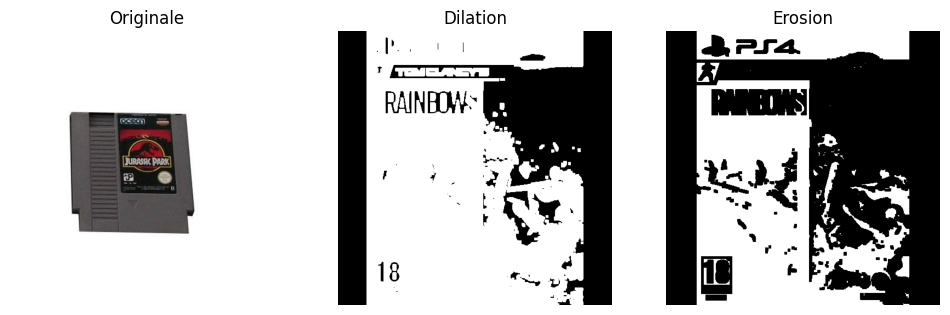

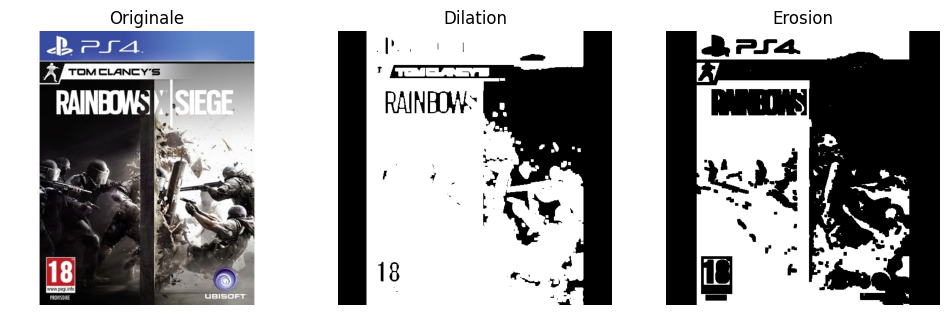

In [27]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convertir en RGB pour Matplotlib
    
    kernel = np.ones((5, 5), np.uint8)
    dilated = cv2.dilate(binary, kernel, iterations=1)
    eroded = cv2.erode(binary, kernel, iterations=1)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 3, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(dilated, cmap='gray')
    axes[1].set_title("Dilation")
    axes[1].axis("off")  # Masquer les axes

    axes[2].imshow(eroded, cmap='gray')
    axes[2].set_title("Erosion")
    axes[2].axis("off")

    # Afficher les images
    plt.show()

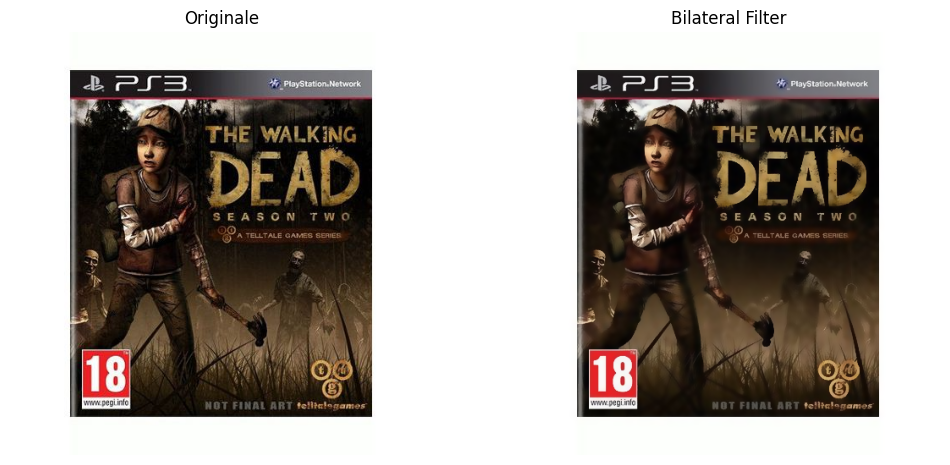

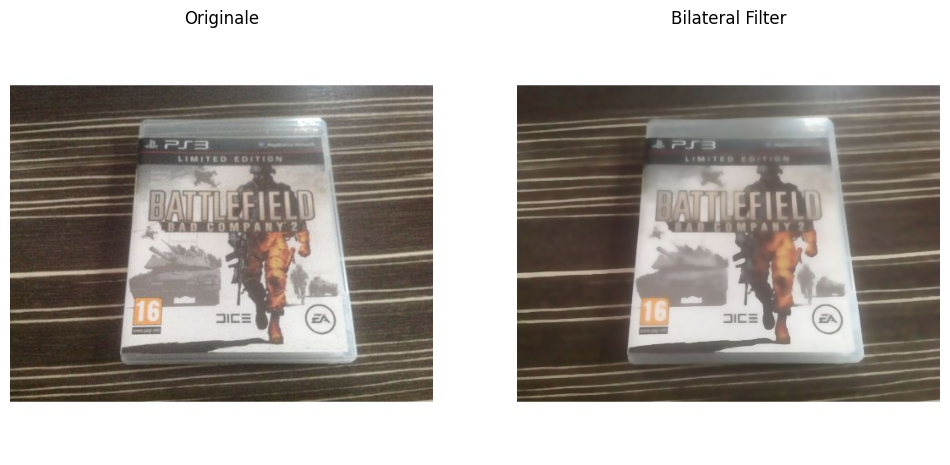

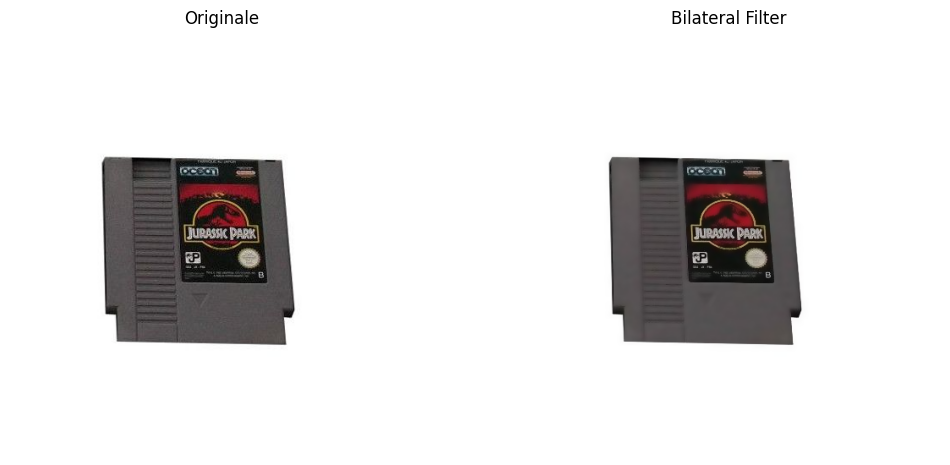

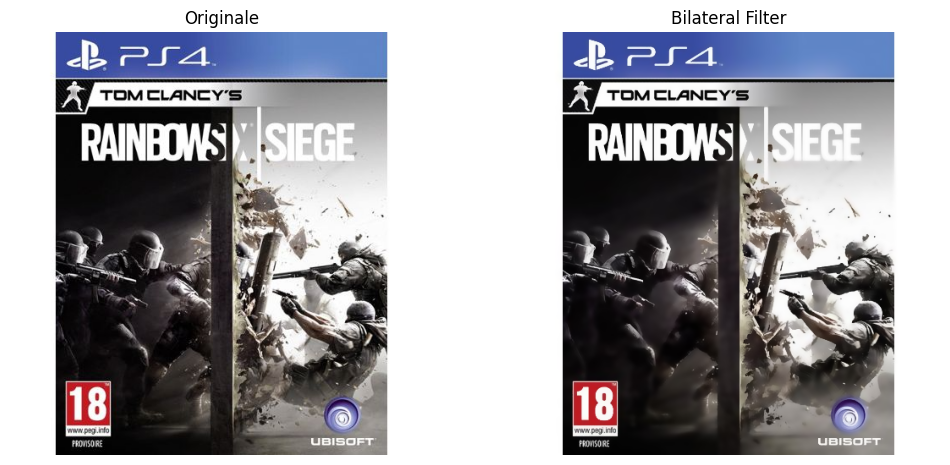

In [28]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convertir en RGB pour Matplotlib
    
    bilateral = cv2.bilateralFilter(img, 9, 75, 75)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(cv2.cvtColor(bilateral, cv2.COLOR_BGR2RGB))
    axes[1].set_title("Bilateral Filter")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

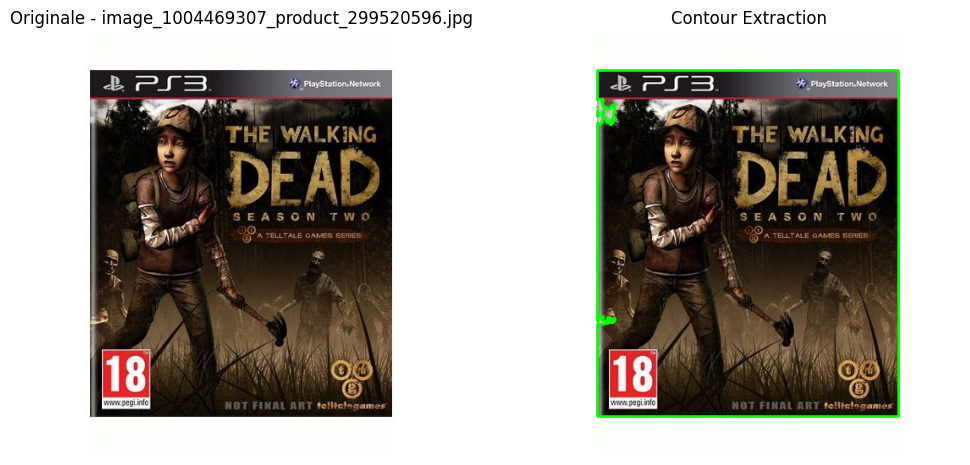

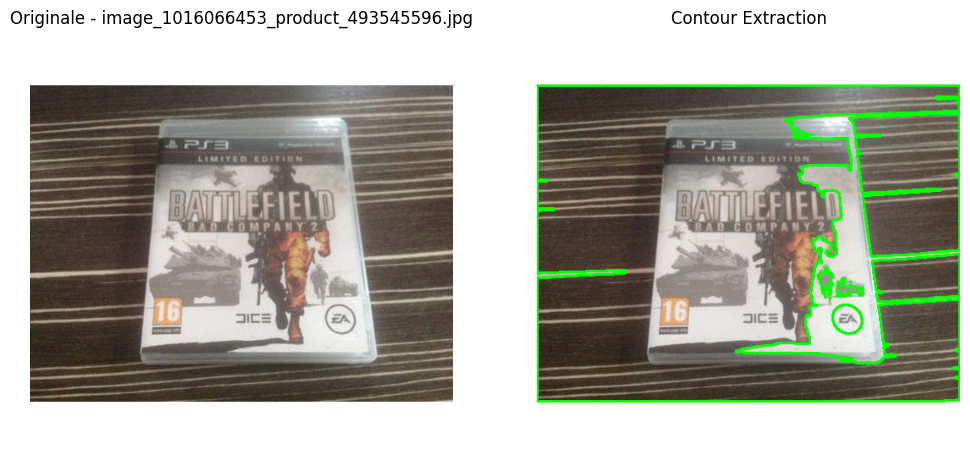

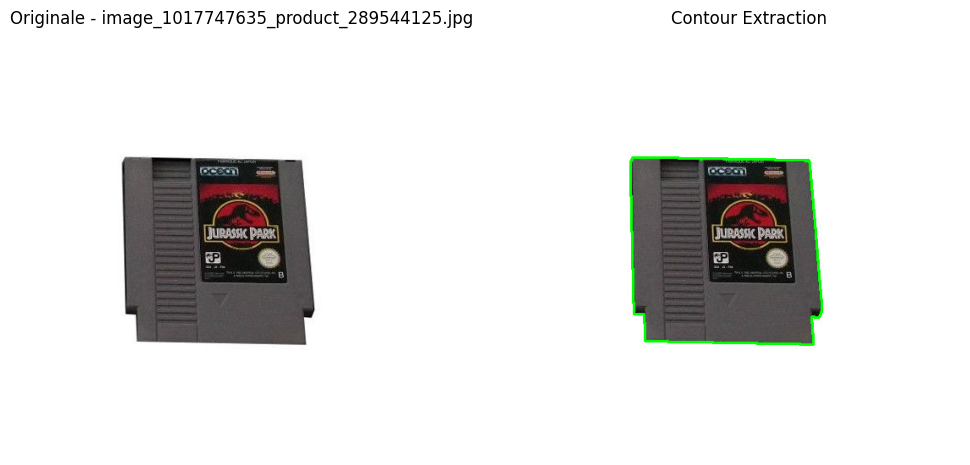

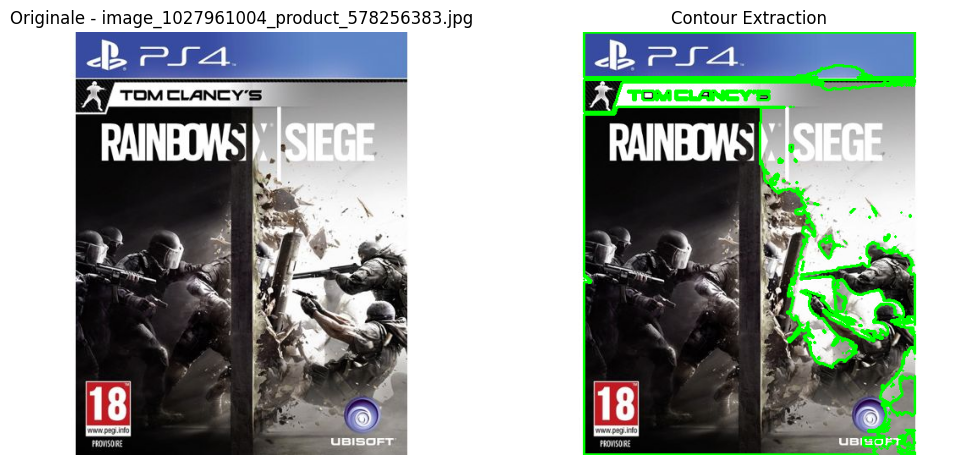

In [29]:
image_files = sorted([f for f in os.listdir(image_folder) if f.endswith((".png", ".jpg", ".jpeg"))])[:4]

for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image en couleur (BGR)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Conversion en niveaux de gris

    # Appliquer un seuillage binaire pour trouver les contours
    _, binary = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)

    # Détection des contours
    contours, _ = cv2.findContours(binary, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    # Dessiner les contours sur une copie de l'image originale
    img_contours = img_rgb.copy()
    cv2.drawContours(img_contours, contours, -1, (0, 255, 0), 2)  # Vert

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title(f"Originale - {img_file}")
    axes[0].axis("off")  # Masquer les axes

    # Affichage de l'image avec contours
    axes[1].imshow(img_contours)
    axes[1].set_title("Contour Extraction")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

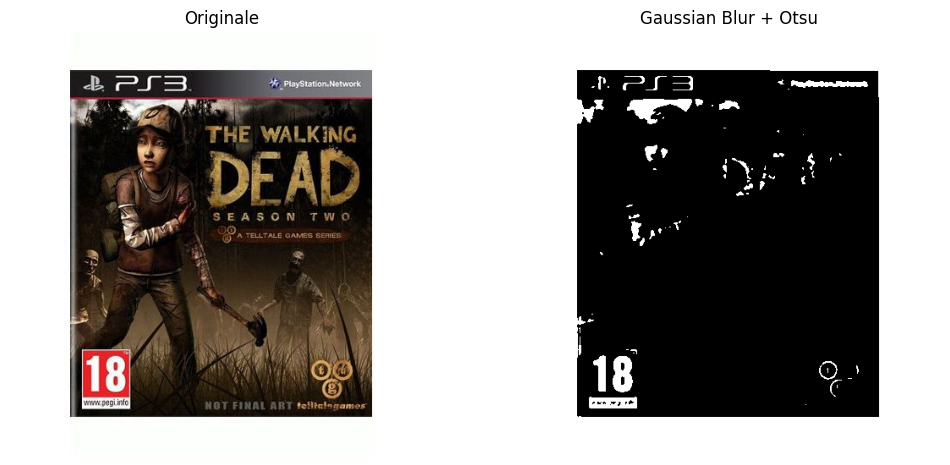

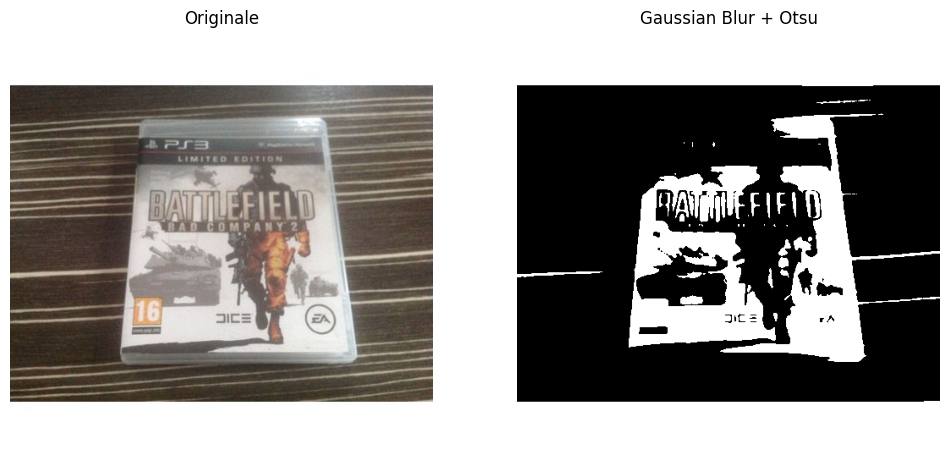

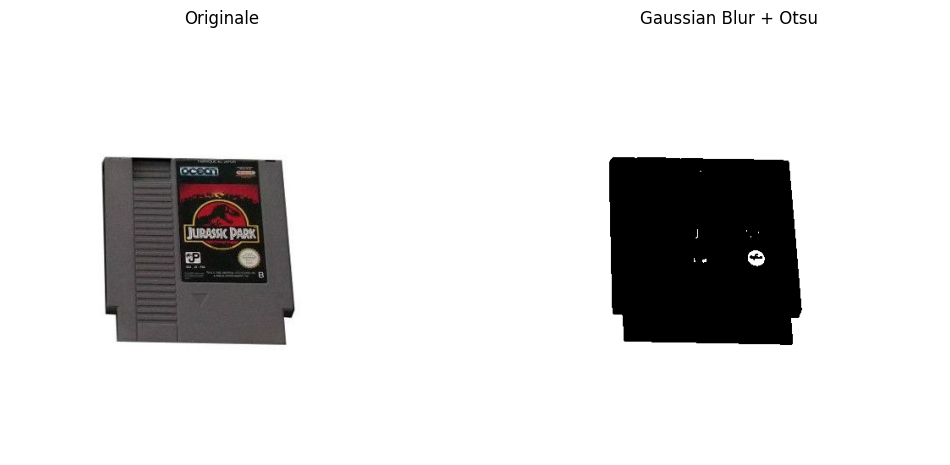

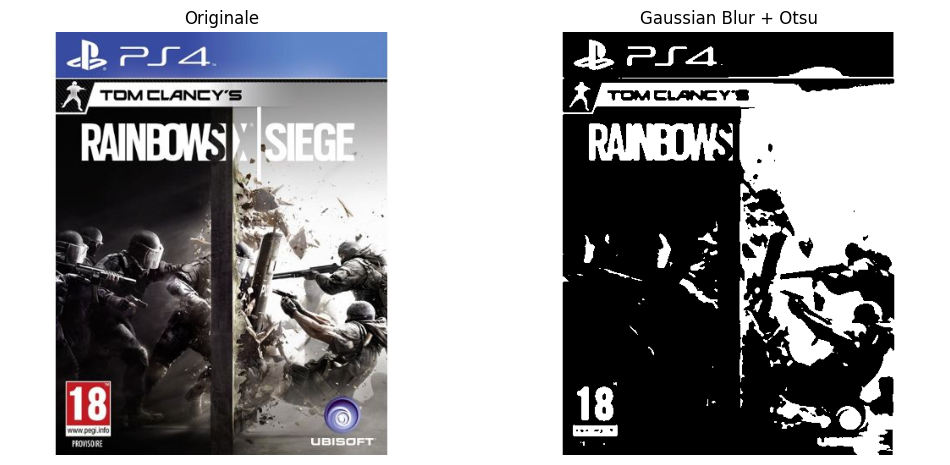

In [30]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Convertir en RGB pour Matplotlib
    
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    blurred = cv2.GaussianBlur(gray, (5,5), 0)
    _, otsu = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(otsu, cmap='gray')
    axes[1].set_title("Gaussian Blur + Otsu")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

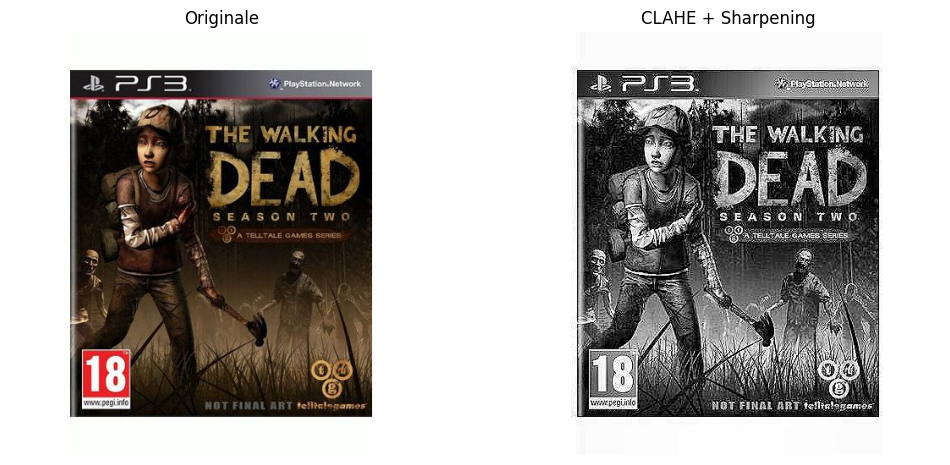

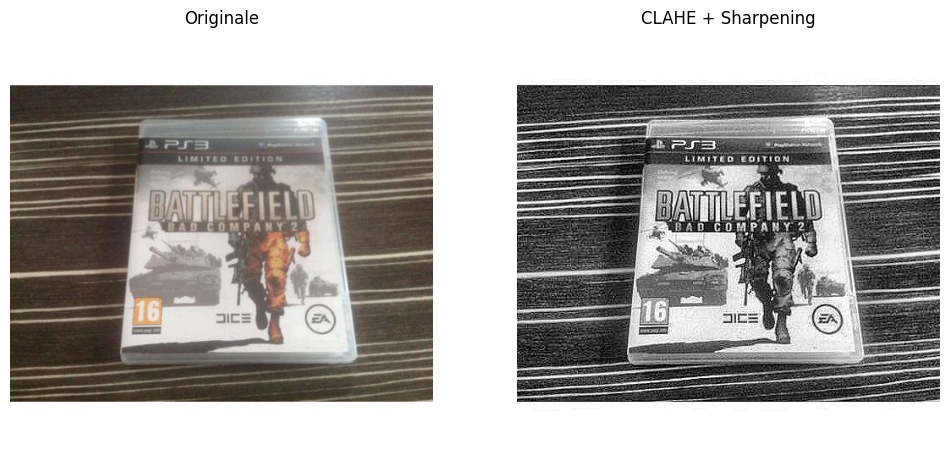

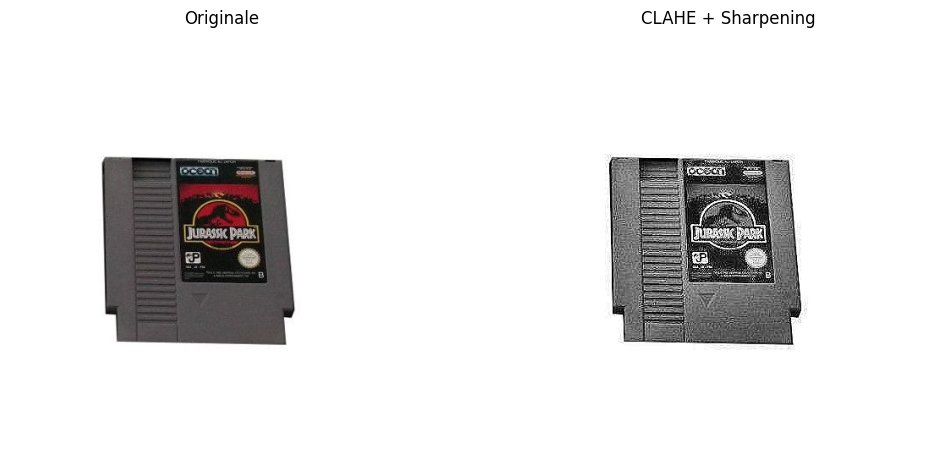

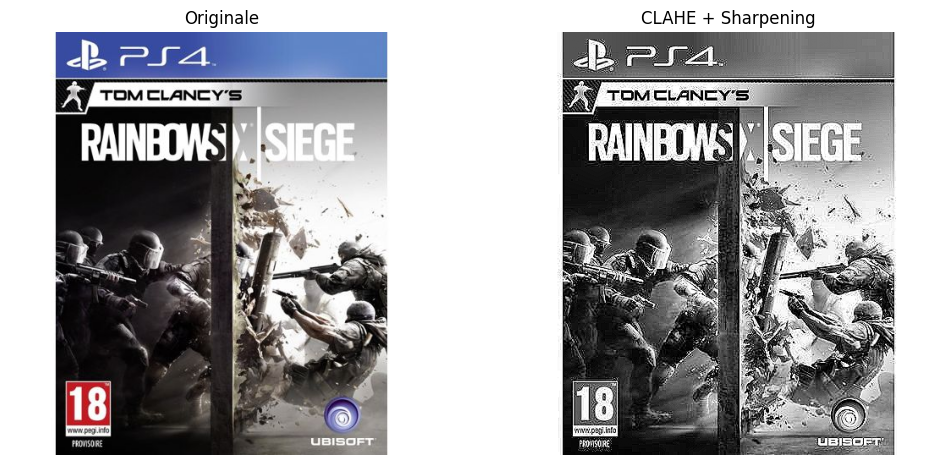

In [31]:
for img_file in image_files:
    # Charger l'image
    img_path = os.path.join(image_folder, img_file)
    img = cv2.imread(img_path)  # Charger l'image
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # Convertir en RGB pour Matplotlib
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)  # Conversion en niveaux de gris

    # Appliquer CLAHE (Contrast Limited Adaptive Histogram Equalization)
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    img_clahe = clahe.apply(gray)

    # Appliquer le Sharpening sur l’image améliorée par CLAHE
    sharpen_kernel = np.array([[0, -1, 0], 
                            [-1, 5, -1], 
                            [0, -1, 0]])
    sharpened = cv2.filter2D(img_clahe, -1, sharpen_kernel)

    # Création de la figure avec deux sous-graphes
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    
    # Affichage de l'image originale
    axes[0].imshow(img_rgb)
    axes[0].set_title("Originale")
    axes[0].axis("off")  # Masquer les axes
    
    # Affichage de l'image avec flou gaussien
    axes[1].imshow(sharpened, cmap='gray')
    axes[1].set_title("CLAHE + Sharpening")
    axes[1].axis("off")  # Masquer les axes

    # Afficher les images
    plt.show()

In [34]:
jeux.isna().sum()

image_name     0
category       0
subcategory    3
dtype: int64

In [39]:
row = jeux[jeux['subcategory'].isna()]
row

,image_name,category,subcategory
4,image_62369530_product_2242928.jpg,SEGA,NaN
29,image_508685383_product_52348929.jpg,PC Gaming,NaN
103,image_1176898982_product_2964292933.jpg,Autre,NaN


In [40]:
jeux['subcategory'].fillna("Autres", inplace=True)

In [47]:
from sklearn.model_selection import StratifiedKFold

# Nombre de batchs voulus
n_splits = 4

# Initialisation de StratifiedKFold
skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# Créer une liste pour stocker les batchs
batchs = []

# Itérer sur les indices des splits
for _, batch_index in skf.split(jeux, jeux["subcategory"]):
    batchs.append(jeux.iloc[batch_index])  # Sélectionner les lignes du batch

# Vérifier le nombre d'éléments par batch
for i, batch in enumerate(batchs):
    print(f"Batch {i+1} : {batch['subcategory'].value_counts().to_dict()}")

Batch 1 : {'Jeux PC': 47, 'Jeux PS2': 8, 'Jeux PS3': 8, 'Jeux Nintendo DS': 7, 'Jeux Xbox 360': 6, 'Jeux PS4': 5, 'Jeux Nintendo Wii': 4, 'Jeux Game Boy Advance': 4, 'Jeux Xbox Classic': 2, 'Jeux PS1': 2, 'Jeux PSP': 2, 'Jeux Xbox One': 2, 'Combo': 2, 'Jeux Game Boy': 1, 'Autres': 1, 'Jeux PSVITA': 1, 'Jeux Nintendo 3DS': 1, 'Saturn': 1, 'MEGA DRIVE': 1, 'Jeux Super Nintendo': 1, 'Jeux V.SMILE': 1, 'Multi-plateformes': 1, 'Jeux Nintendo Switch': 1, 'Leapfrog': 1, 'SNES': 1, 'Non pertinent': 1, 'Jeux Nintendo Wii U': 1, 'Gamecube': 1, 'Jeux Android': 1, 'Jeux PC Mac': 1, 'Autre categorie': 1}
Batch 2 : {'Jeux PC': 47, 'Jeux Nintendo DS': 8, 'Jeux PS3': 8, 'Jeux PS2': 7, 'Jeux Xbox 360': 6, 'Jeux PS4': 4, 'Jeux Nintendo Wii': 4, 'Jeux PS1': 3, 'Jeux Game Boy Advance': 3, 'Jeux Nintendo Wii U': 2, 'Jeux Xbox One': 2, 'Jeux Xbox Classic': 2, 'Jeux PSP': 2, 'Combo': 2, 'Jeux Super Nintendo': 1, 'MEGA DRIVE': 1, 'Jeux Nintendo 3DS': 1, 'Jeux PSVITA': 1, 'Jeux Game Boy': 1, 'Genesis': 1, 'Non

f:\Document\Datascientest\Projet_final\repo_github\Projet_3\venv\Lib\site-packages\sklearn\model_selection\_split.py:805: UserWarning:

The least populated class in y has only 1 members, which is less than n_splits=4.



In [48]:
# Créer un dossier pour enregistrer les batchs (optionnel)
output_folder = "batchs_csv"
os.makedirs(output_folder, exist_ok=True)

# Sauvegarder chaque batch dans un fichier CSV séparé
for i, batch in enumerate(batchs):
    file_name = os.path.join(output_folder, f"batch_{i+1}.csv")
    batch.to_csv(file_name, index=False, encoding="utf-8")
    print(f"Batch {i+1} enregistré sous : {file_name}")

Batch 1 enregistré sous : batchs_csv\batch_1.csv
Batch 2 enregistré sous : batchs_csv\batch_2.csv
Batch 3 enregistré sous : batchs_csv\batch_3.csv
Batch 4 enregistré sous : batchs_csv\batch_4.csv


In [51]:
batch_1 = pd.read_csv("batchs_csv/batch_1.csv")
batch_1

,image_name,category,subcategory
0,image_659698_product_822774.jpg,PlayStation,Jeux PS1
1,image_54547530_product_929584.jpg,PC Gaming,Jeux PC
2,image_62369530_product_2242928.jpg,SEGA,Autres
3,image_283812671_product_15511645.jpg,PlayStation,Jeux PS2
4,image_848934197_product_80184781.jpg,Nintendo,Jeux Game Boy
...,...,...,...
112,image_1236934770_product_3716121141.jpg,Autre,Combo
113,image_1236935361_product_3716121933.jpg,Autre,Combo
114,image_1315355210_product_4205293139.jpg,Nintendo,Jeux Nintendo Wii
115,image_927527365_product_180498882.jpg,PlayStation,Jeux PS2
